# Advanced Lane Lines

Udacity's Self-driving Car Nanodegree Program

## 1. Camera Calibration

Using image: ./camera_cal/calibration3.jpg
Using image: ./camera_cal/calibration19.jpg
Using image: ./camera_cal/calibration8.jpg
Using image: ./camera_cal/calibration7.jpg
Using image: ./camera_cal/calibration6.jpg
Using image: ./camera_cal/calibration10.jpg
Using image: ./camera_cal/calibration2.jpg
Using image: ./camera_cal/calibration13.jpg
Using image: ./camera_cal/calibration1.jpg
Using image: ./camera_cal/calibration14.jpg
Using image: ./camera_cal/calibration17.jpg
Using image: ./camera_cal/calibration9.jpg
Using image: ./camera_cal/calibration11.jpg
Using image: ./camera_cal/calibration4.jpg
Using image: ./camera_cal/calibration16.jpg
Using image: ./camera_cal/calibration12.jpg
Using image: ./camera_cal/calibration18.jpg
Using image: ./camera_cal/calibration20.jpg
Using image: ./camera_cal/calibration5.jpg
Using image: ./camera_cal/calibration15.jpg
Done!


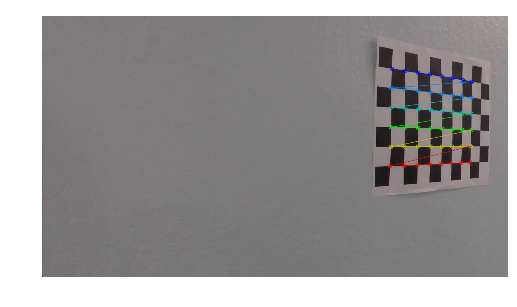

In [1]:
########################################################
# Define object points (3D) and image points (2D)
########################################################

import glob
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

images = glob.glob('./camera_cal/calibration*.jpg')
objpoints = [] # Coordinate corners of the real chessboard object
imgpoints = [] # Coordinate corners of the image of chessboard

nx = 8 # horizontal corners
ny = 6 # vertical corners

objp = np.zeros((nx*ny, 3), np.float32)
objp[:, :2] = np.mgrid[:nx, :ny].T.reshape(-1, 2)

for fname in images:
    print("Using image: " + fname)
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)

        # Display the corners
        img = cv2.drawChessboardCorners(img, (8,6), corners, ret)
        plt.axis("off")
        plt.imshow(img)
        
print("Done!")

## 2. Distortion Correction

In [2]:
########################################################
# Calibrate camera with object points (3D) and image 
# points (2D)
########################################################

def calc_undistort(img_, objpoints_, imgpoints_):
    ret_, mtx_, dist_, rvecs_, tvecs_ = cv2.calibrateCamera(objpoints_, imgpoints_, img_.shape[0:2], None, None)
    undist_ = cv2.undistort(img_, mtx_, dist_, None, mtx_)
    return undist_

### _Test_

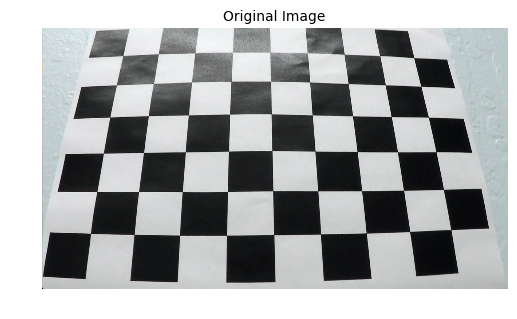

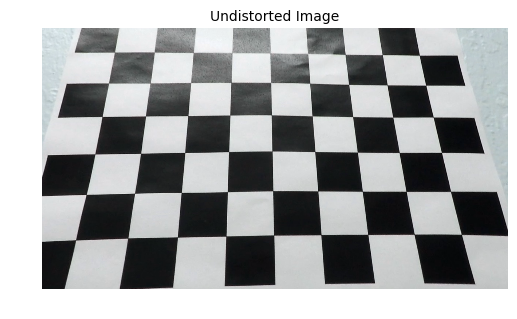

In [3]:
def test_calc_undistort():
    img = cv2.imread("./camera_cal/calibration3.jpg")
    img_undist = calc_undistort(img, objpoints, imgpoints)

    # display the images

    plt.figure()
    plt.imshow(img)
    plt.axis("off")
    plt.title('Original Image', fontsize=10)

    plt.figure()
    plt.imshow(img_undist)
    plt.axis("off")
    plt.title('Undistorted Image', fontsize=10)
    
test_calc_undistort()

## 3. Perspective Tranformation

In [6]:
from matplotlib.path import Path
import matplotlib.patches as patches

def calc_perspective_matrices(objpoints_, imgpoints_, im_name_="./test_images/straight_lines1.jpg", top_offset_=(128, 134), bottom_offset_=(386, 413), heights_=(505, 680), factor_ = 0.75, draw_images_=False):
    # points that form the trapezoid-
    tol_, tor_ = top_offset_[0], top_offset_[1]# horizontal top offset from center
    bol_, bor_ = bottom_offset_[0], bottom_offset_[1] # horizontal bottom offset from center
    th_ = heights_[0] # y coordinate for top points
    tb_ = heights_[1] # y coordinate for bottom points

    test_image_ = cv2.imread(im_name_)
    img_undist_ = calc_undistort(test_image_, objpoints_, imgpoints_)
    h_, w_, d_ = test_image_.shape
    image_size_ = (w_, h_)
    hw_ = w_/2 # half width

    # source points from origwarped_imageinal image
    # top_left, top_right, bottom_left, bottom_right
    points_ = [[hw_ - tol_, th_],[hw_ + tor_, th_],[hw_ - bol_, tb_],[hw_ + bor_, tb_]]
    src_p_ = np.array(points_).astype('float32')

    # destination points in the transformed image
    # top_left, top_right, bottom_left, bottom_right
    points_ = [[hw_ - bol_, th_ * factor_],[hw_ + bor_, th_ * factor_],[hw_ - bol_, tb_],[hw_ + bor_, tb_]]
    dst_p_ = np.array(points_).astype('float32')

    M_ = cv2.getPerspectiveTransform(src_p_, dst_p_)
    MI_ = cv2.getPerspectiveTransform(dst_p_, src_p_)
    
    if draw_images_ is True:
        # Draw the test image and the polygon
        verts_ = [src_p_[0], src_p_[2], src_p_[3], src_p_[1], src_p_[0]]
        codes_ = [Path.MOVETO,
                 Path.LINETO,
                 Path.LINETO,
                 Path.LINETO,
                 Path.CLOSEPOLY
                 ]
        path_ = Path(verts_, codes_)
        patch_ = patches.PathPatch(path_, color='red', fill=False, lw=2)

        plt.figure()
        ax_ = plt.subplot()
        ax_.axis("off")
        ax_.add_patch(patch_)
        ax_.imshow(cv2.cvtColor(img_undist_, cv2.COLOR_BGR2RGB))
        ax_.set_title('Original Undistorted Image', fontsize=10)

        warped_ = cv2.warpPerspective(img_undist_, M_, image_size_, flags=cv2.INTER_LINEAR)

        # Draw the warped image and the polygon
        verts_ = [[dst_p_[0][0], 0], 
                 dst_p_[2], 
                 dst_p_[3], 
                 [dst_p_[1][0], 0], 
                 [dst_p_[0][0], 0]
                ]
        codes_ = [Path.MOVETO,
                 Path.LINETO,
                 Path.LINETO,
                 Path.LINETO,
                 Path.CLOSEPOLY
                 ]
        path_ = Path(verts_, codes_)
        patch_ = patches.PathPatch(path_, color='red', fill=False, lw=2)

        plt.figure()
        ax_ = plt.subplot()
        ax_.axis("off")
        ax_.add_patch(patch_)
        ax_.imshow(cv2.cvtColor(warped_, cv2.COLOR_BGR2RGB))
        ax_.set_title('Warped Image', fontsize=10)
        
        unwarped_ = cv2.warpPerspective(warped_, MI_, image_size_, flags=cv2.INTER_LINEAR)
        plt.figure()
        ax_ = plt.subplot()
        ax_.axis("off")
        ax_.imshow(cv2.cvtColor(unwarped_, cv2.COLOR_BGR2RGB))
        ax_.set_title('Unwarped Image', fontsize=10)
        
    return M_, MI_

### _Test_

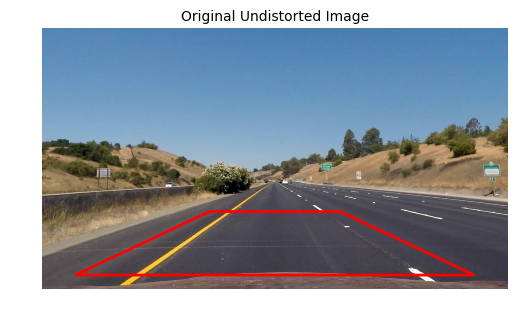

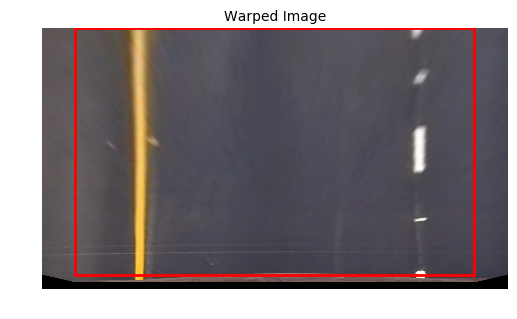

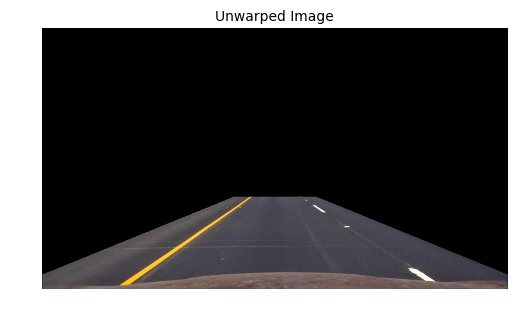

In [7]:
def test_calc_perspective_matrices():
    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights = (505, 680)
    factor = 0.75

    calc_perspective_matrices(objpoints, imgpoints,"./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, True)
    
test_calc_perspective_matrices()

## 4. Gradient Thresholding

In [8]:
########################################################
# Functions to identify lane lines 
########################################################

def abs_sobel_threshold(img_, orient_='x', sobel_kernel_=21, thresh_=(20, 80)):
    gray_ = cv2.cvtColor(img_, cv2.COLOR_BGR2RGB)
    gray_ = cv2.cvtColor(gray_, cv2.COLOR_RGB2Luv)
    gray_ = gray_[:,:,2] # detects yellows
    
    x_g_, y_g_ = 1, 0
    if orient_ ==  'y':
        x_g_, y_g_ = 0, 1
    
    # Calculate directional gradient
    sobel_ = np.absolute(cv2.Sobel(gray_, cv2.CV_64F, x_g_, y_g_, ksize=sobel_kernel_))
    sobel_scaled_ = np.uint8(255 * sobel_ / np.max(sobel_))
    
    # Apply threshold
    binary_ = np.zeros_like(sobel_scaled_)
    binary_[(sobel_scaled_ > thresh_[0]) & (sobel_scaled_ <= thresh_[1])] = 1
    grad_binary_ = np.copy(binary_)
    
    return grad_binary_

def mag_threshold(img_, sobel_kernel_=3, mag_thresh_=(0, 255)):
    gray_ = cv2.cvtColor(img_, cv2.COLOR_BGR2RGB)
    gray_ = cv2.cvtColor(gray_, cv2.COLOR_RGB2Luv)
    gray_ = gray_[:,:,2]
    
    # Calculate gradient magnitude
    sobel_x_ = np.absolute(cv2.Sobel(gray_, cv2.CV_64F, 1, 0, ksize=sobel_kernel_))
    sobel_y_ = np.absolute(cv2.Sobel(gray_, cv2.CV_64F, 0, 1, ksize=sobel_kernel_))
    abs_sobel_xy_ = np.sqrt(sobel_x_**2 + sobel_y_**2)
    sobel_scaled_ = np.uint8(255 * abs_sobel_xy_ / np.max(abs_sobel_xy_))
    
    # Apply threshold
    binary_ = np.zeros_like(sobel_scaled_)
    binary_[(sobel_scaled_ > mag_thresh_[0]) & (sobel_scaled_ <= mag_thresh_[1])] = 1
    mag_binary_ = np.copy(binary_)
   
    return mag_binary_

def dir_threshold(img_, sobel_kernel_=3, dir_thresh=(0, np.pi/2)):
    gray_ = cv2.cvtColor(img_, cv2.COLOR_BGR2RGB)
    gray_ = cv2.cvtColor(gray_, cv2.COLOR_RGB2Luv)
    gray_ = gray_[:,:,2]
    
    # Calculate gradient direction
    sobel_x_ = np.absolute(cv2.Sobel(gray_, cv2.CV_64F, 1, 0, ksize=sobel_kernel_))
    sobel_y_ = np.absolute(cv2.Sobel(gray_, cv2.CV_64F, 0, 1, ksize=sobel_kernel_))

    abs_sobel_x_ = np.sqrt(sobel_x_**2)
    abs_sobel_y_ = np.sqrt(sobel_y_**2)
    
    gradient_dir_ = np.arctan2(abs_sobel_y_, abs_sobel_x_)
    
    # Apply threshold
    binary_ = np.zeros_like(abs_sobel_x_)
    binary_[(gradient_dir_ > dir_thresh[0]) & (gradient_dir_ <= dir_thresh[1])] = 1
    dir_binary_ = np.copy(binary_)
    
    return dir_binary_

### _Test_

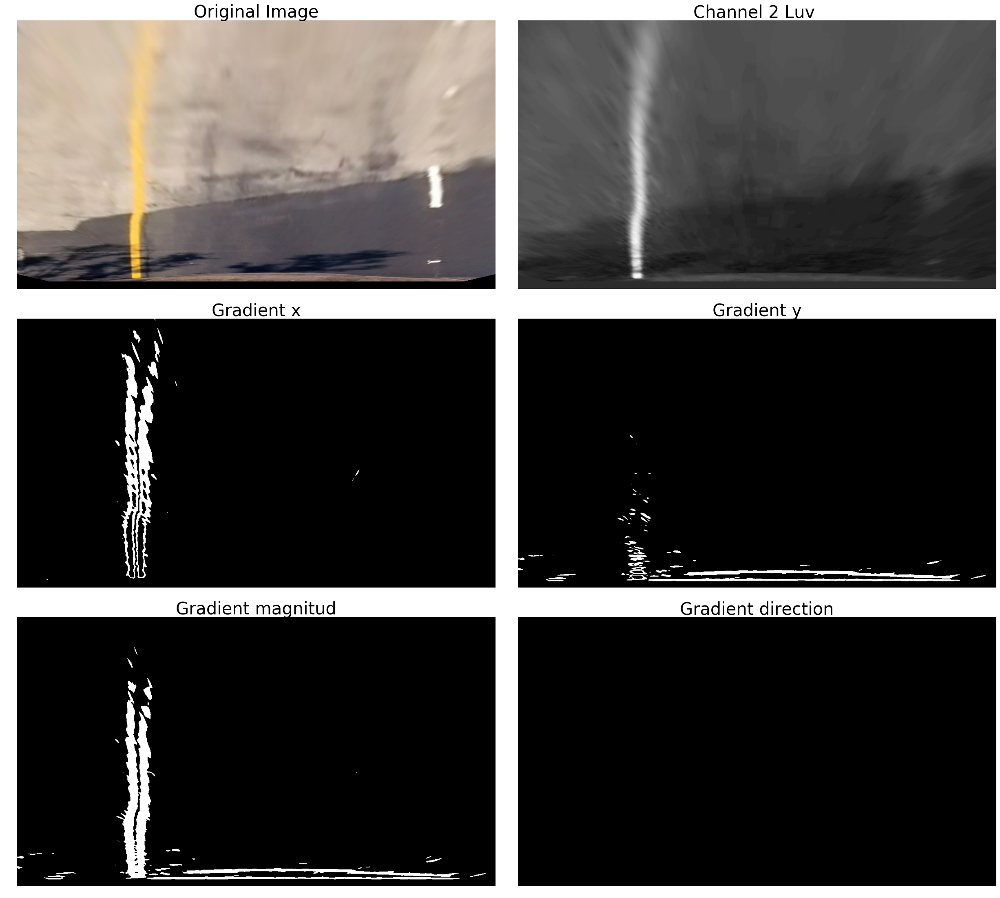

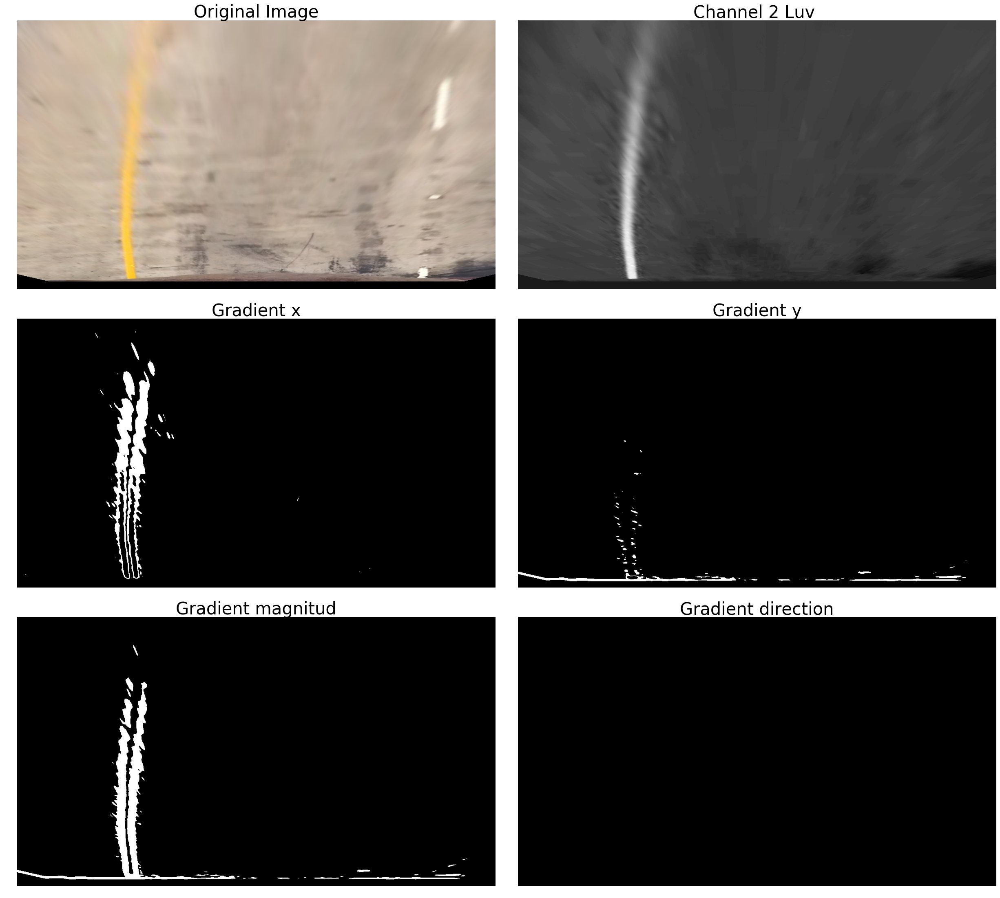

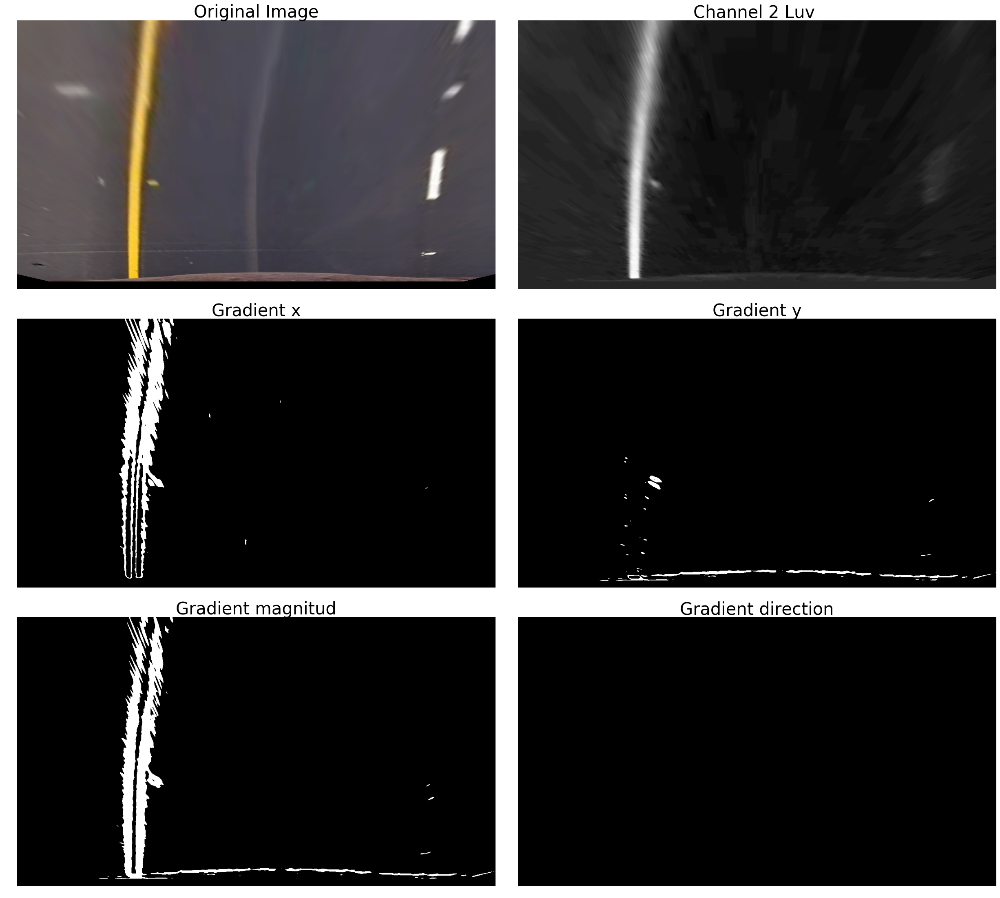

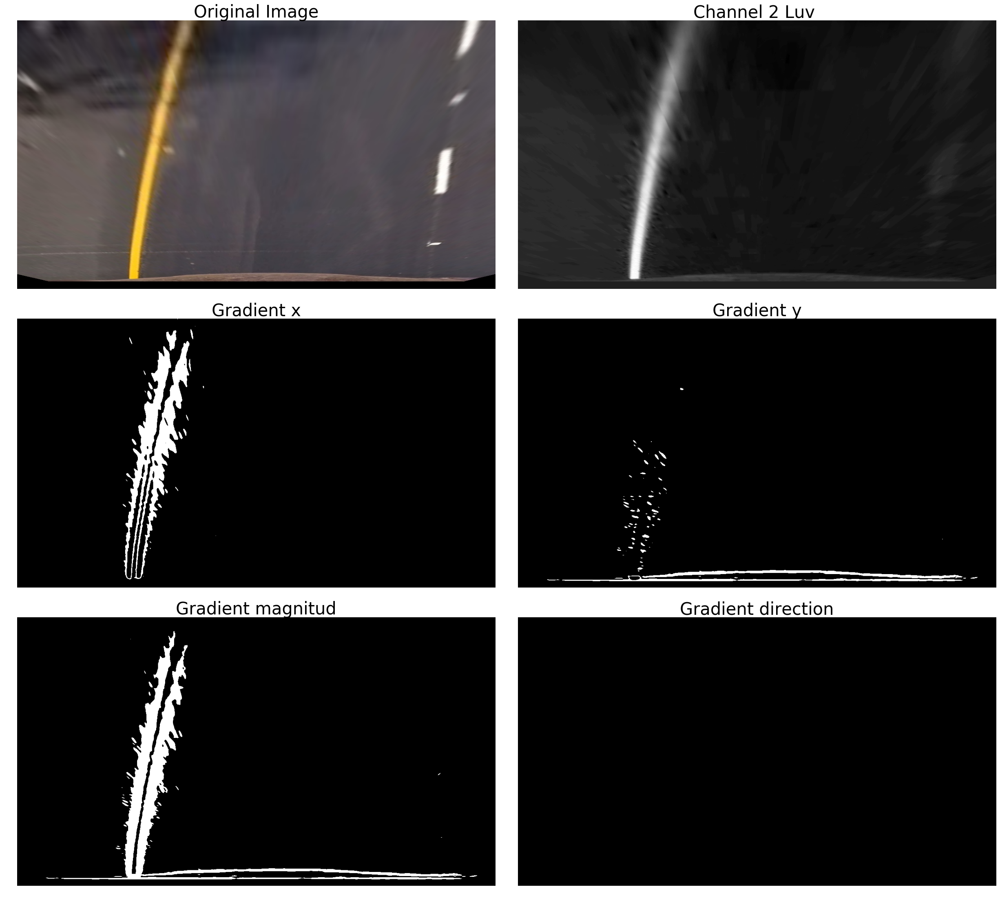

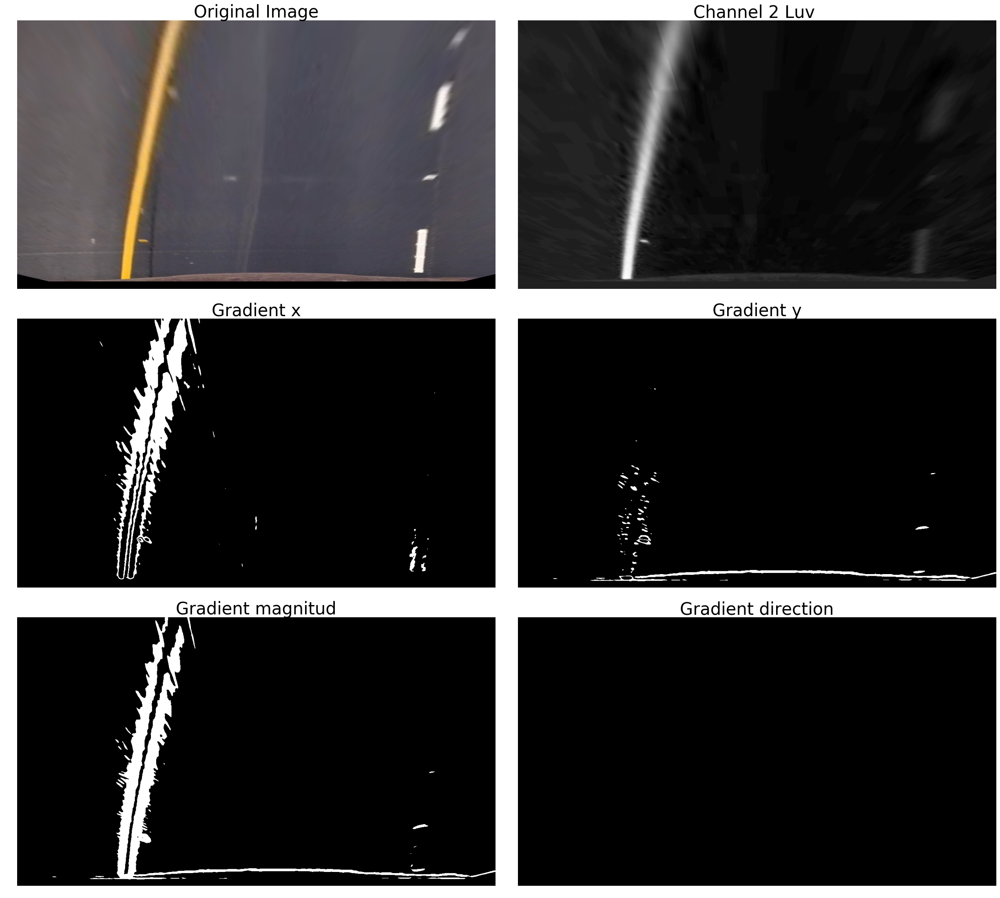

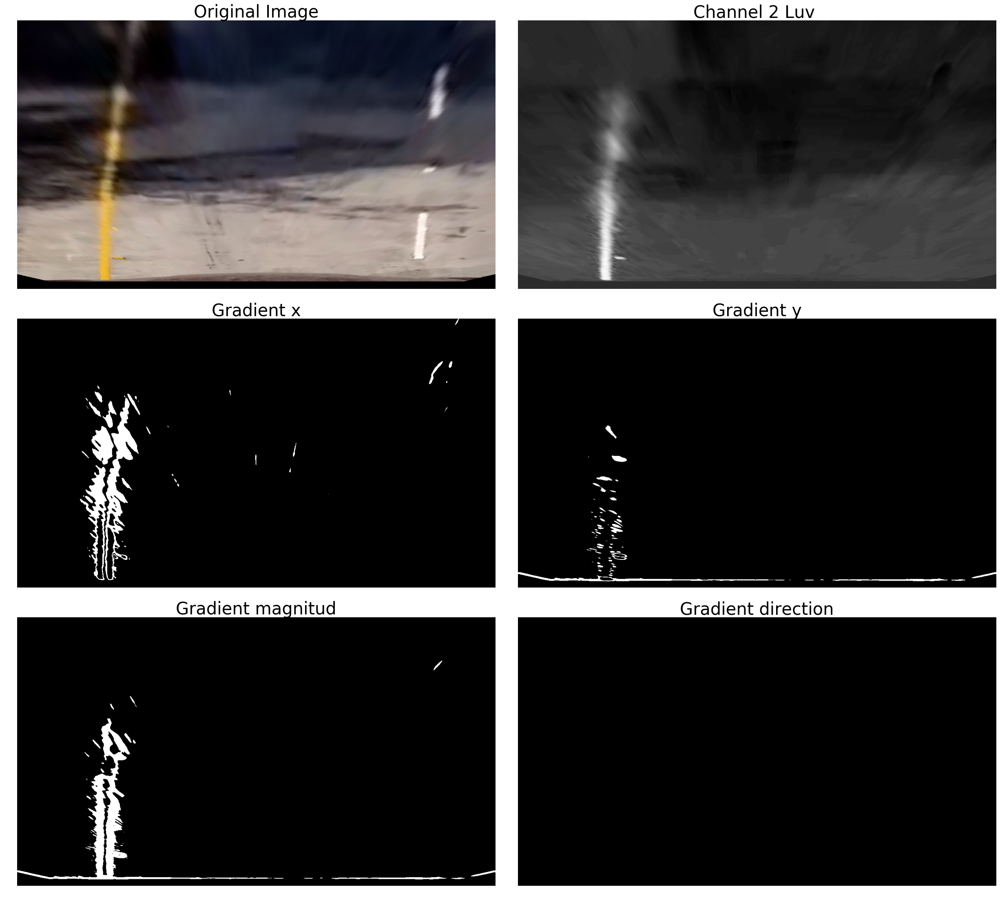

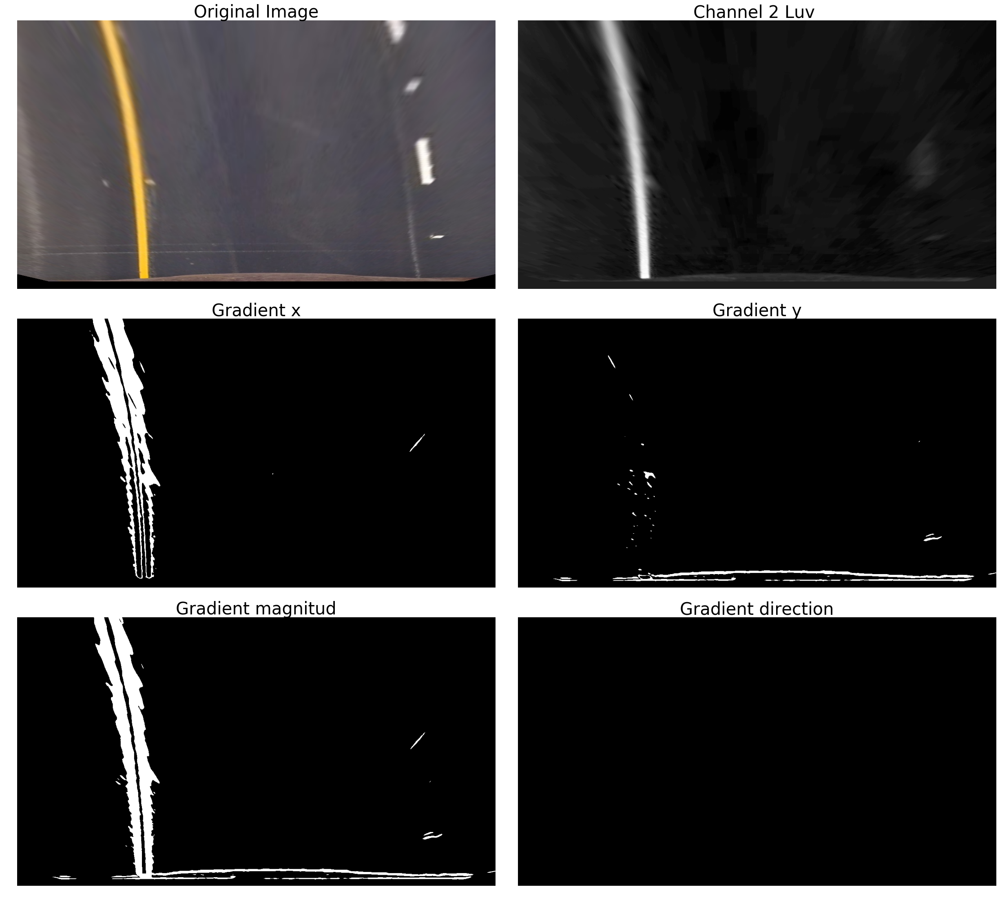

In [9]:
def test_gradient_thresholdings():
    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights=(505, 680)
    factor = 0.75
    
    M, MI = calc_perspective_matrices(objpoints, imgpoints, "./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, False)

    # Choose a Sobel kernel size
    sobel_kernel = 21 # Choose a larger odd number to smooth gradient measurements
    sobel_thresh = (20, 80)

    mag_sobel_kernel = 21
    mag_thresh=(20, 255)

    dir_sobel_kernel = 21
    dir_thresh=(np.pi*0.9, 2*np.pi*1.1)

    images = glob.glob('./test_images/test*.jpg')
    for fname in images:
        test_image = cv2.imread(fname)
        undist_image = calc_undistort(test_image, objpoints, imgpoints)
        h, w, d = test_image.shape

        image = cv2.warpPerspective(undist_image, M, (w, h), flags=cv2.INTER_LINEAR)
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        gray = cv2.cvtColor(gray, cv2.COLOR_RGB2Luv)
        gray = gray[:,:,2]

        # Apply each of the thresholding functions
        gradx = abs_sobel_threshold(image, 'x', sobel_kernel, sobel_thresh)
        grady = abs_sobel_threshold(image, 'y', sobel_kernel, sobel_thresh)
        mag_binary = mag_threshold(image, mag_sobel_kernel, mag_thresh)
        dir_binary = dir_threshold(image, dir_sobel_kernel, dir_thresh)

        # display the images part 1
        f, (ax1, ax2, ax3) = plt.subplots(3, 2, figsize=(24, 24))
        f.tight_layout()

        ax1[0].axis("off")
        ax1[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax1[0].set_title('Original Image', fontsize=30)

        ax1[1].axis("off")
        ax1[1].imshow(gray, cmap="gray")
        ax1[1].set_title('Channel 2 Luv ', fontsize=30)

        ax2[0].axis("off")
        ax2[0].imshow(gradx, cmap="gray")
        ax2[0].set_title('Gradient x', fontsize=30)

        ax2[1].axis("off")
        ax2[1].imshow(grady, cmap="gray")
        ax2[1].set_title('Gradient y', fontsize=30)

        ax3[0].axis("off")
        ax3[0].imshow(mag_binary, cmap="gray")
        ax3[0].set_title('Gradient magnitud', fontsize=30)

        ax3[1].axis("off")
        ax3[1].imshow(dir_binary, cmap="gray")
        ax3[1].set_title('Gradient direction', fontsize=30)

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

test_gradient_thresholdings()
 

## 5. Color Thresholding

In [10]:
def color_threshold(img_):
        
    # Detect yellow
    r_l_, r_h_ = 200, 255
    g_l_, g_h_ = 100, 255
    b_l_, b_h_ = 40, 150
        
    y_ = np.copy(img_)
    b_, g_, r_ = y_[:,:,0], y_[:,:,1], y_[:,:,2]
    bools_y_ = (b_ >= b_l_) & (b_ <= b_h_) & (g_ >= g_l_) & (g_ <= g_h_) & (r_ >= r_l_) & (r_ <= r_h_)
  
    binary_y_ = np.zeros_like(b_)
    binary_y_[bools_y_ == True] = 1
    histogram_y_ = np.sum(binary_y_[binary_y_.shape[0]/2:,:], axis=0)
    max_y_ = np.argmax(histogram_y_)
    
    #Detect white
    r_l_, r_h_ = 190, 255
    g_l_, g_h_ = 190, 255
    b_l_, b_h_ = 190, 255
        
    y_ = np.copy(img_)
    b_, g_, r_ = y_[:,:,0], y_[:,:,1], y_[:,:,2]
    bools_w_ = (b_ >= b_l_) & (b_ <= b_h_) & (g_ >= g_l_) & (g_ <= g_h_) & (r_ >= r_l_) & (r_ <= r_h_)
  
    binary_w_ = np.zeros_like(b_)
    binary_w_[bools_w_ == True] = 1
    histogram_w_ = np.sum(binary_w_[binary_w_.shape[0]/2:,:], axis=0)
    max_w_ = np.argmax(histogram_w_)
 
    binary_ = np.zeros_like(b_) # placeholder line
    binary_[(bools_y_ == True) | (bools_w_ == True)] = 1
    binary_output_ = np.copy(binary_)
    
    return binary_output_, max_y_, max_w_

### _Test_

/home/sebastian/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:14: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/home/sebastian/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:28: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


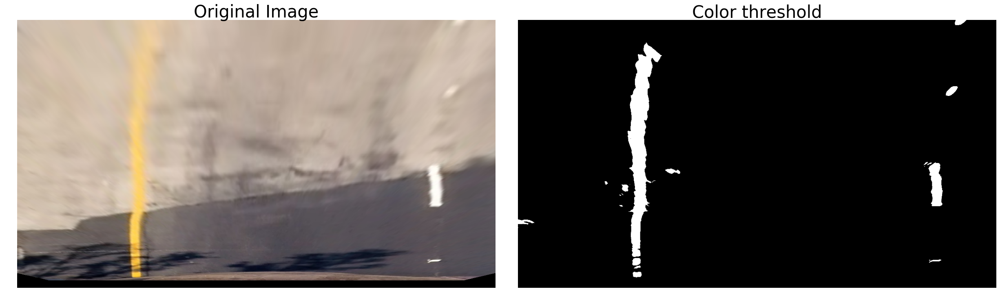

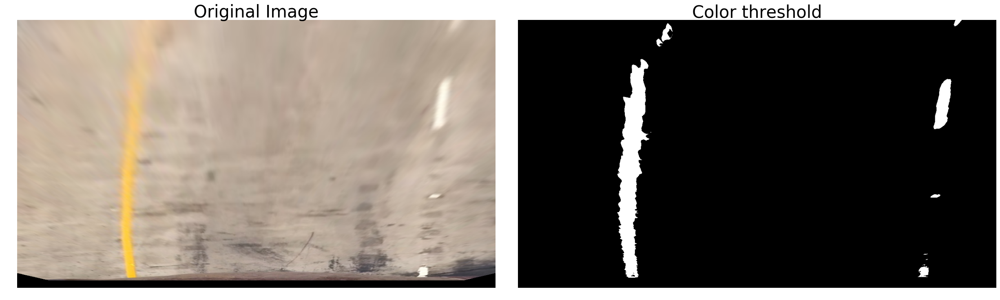

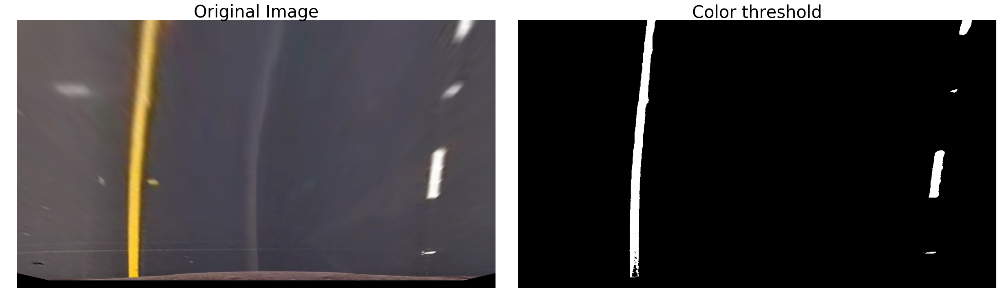

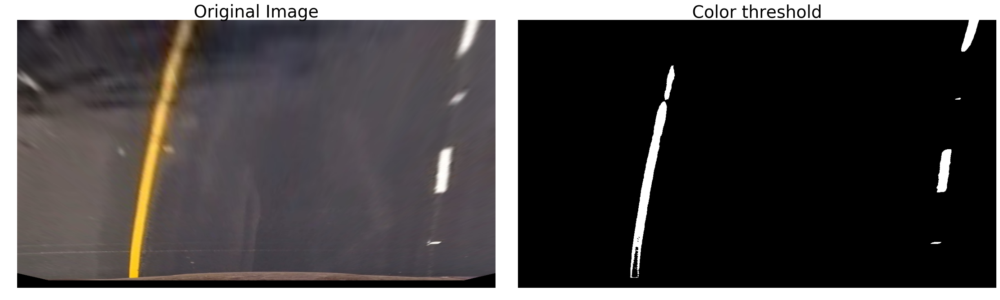

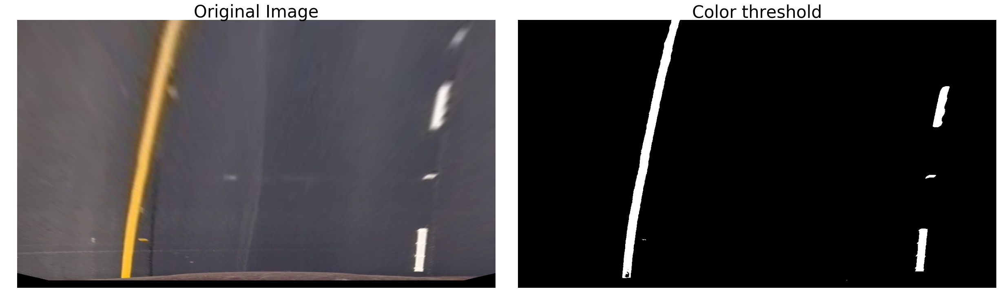

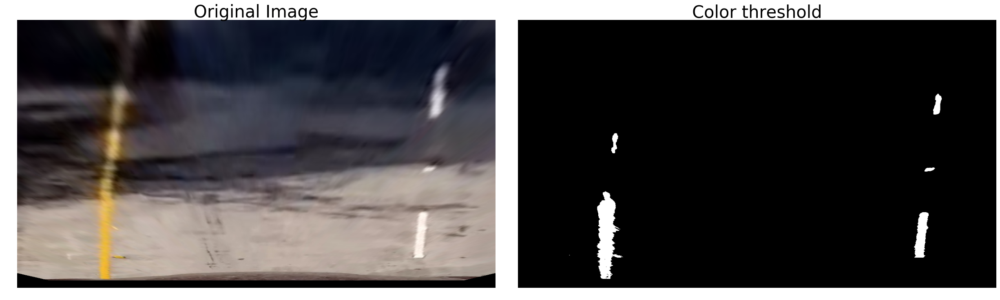

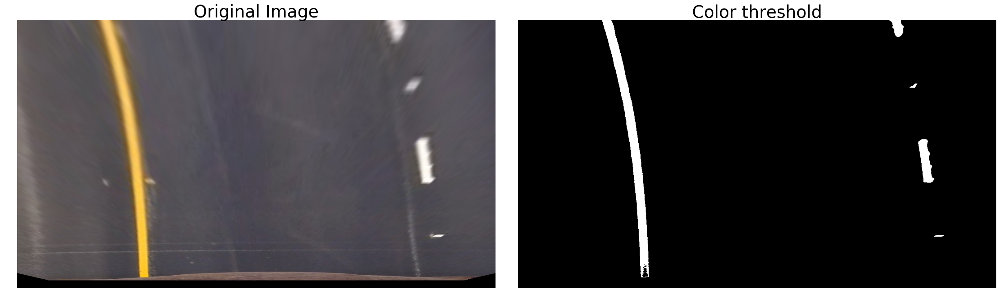

In [11]:
def test_color_thresholding():
    
    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights=(505, 680)
    factor = 0.75
    M, MI = calc_perspective_matrices(objpoints, imgpoints, "./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, False)

    images = glob.glob('./test_images/test*.jpg')
    for fname in images:
        test_image = cv2.imread(fname)
        undist_image = calc_undistort(test_image, objpoints, imgpoints)
        h, w, d = test_image.shape

        image = cv2.warpPerspective(undist_image, M, (w, h), flags=cv2.INTER_LINEAR)

        hsv_binary, my, mw = color_threshold(image)

        # display the images
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()

        ax1.axis("off")
        ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax1.set_title('Original Image', fontsize=30)

        ax2.axis("off")
        ax2.imshow(hsv_binary, cmap="gray")
        ax2.set_title('Color threshold', fontsize=30)

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        
test_color_thresholding()

## 6. Combined Thresholding

In [13]:
def combined_thresholding(img_, sx_thresh_=(20, 80)):
    # Choose a Sobel kernel size
    ksize_ = 21 # Choose a larger odd number to smooth gradient measurements
    sobel_x_ = abs_sobel_threshold(img_, orient_='x', sobel_kernel_=ksize_, thresh_=sx_thresh_)

    # Apply color thresholding
    color_, my_, mw_ = color_threshold(img_)
    h_, w_ = color_.shape
    
    binary_ = np.zeros_like(sobel_x_)
    binary_[(color_ == 1) | (sobel_x_ == 1)] = 1
    
    return binary_

### _Test_

/home/sebastian/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:14: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/home/sebastian/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:28: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


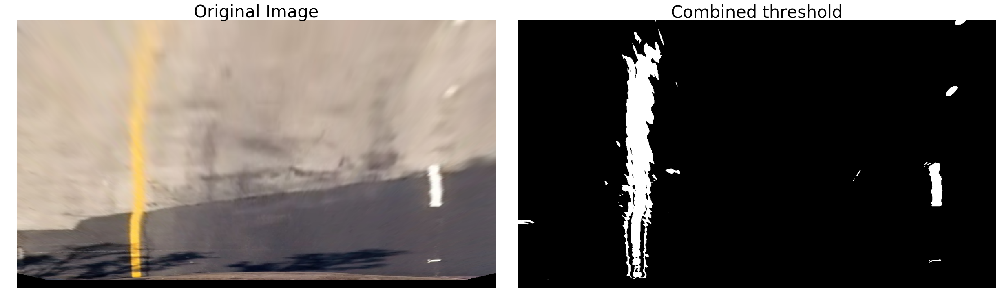

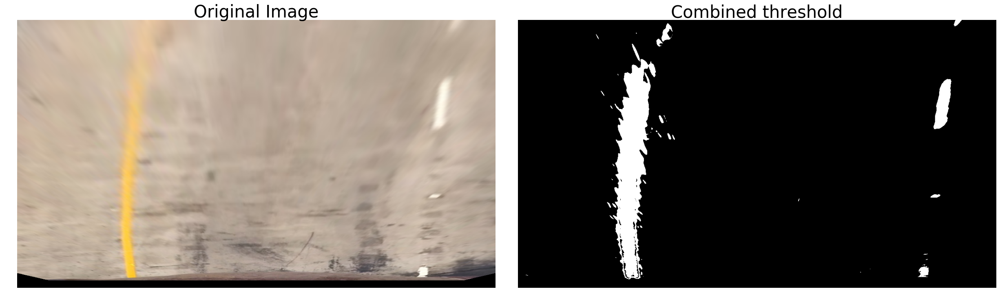

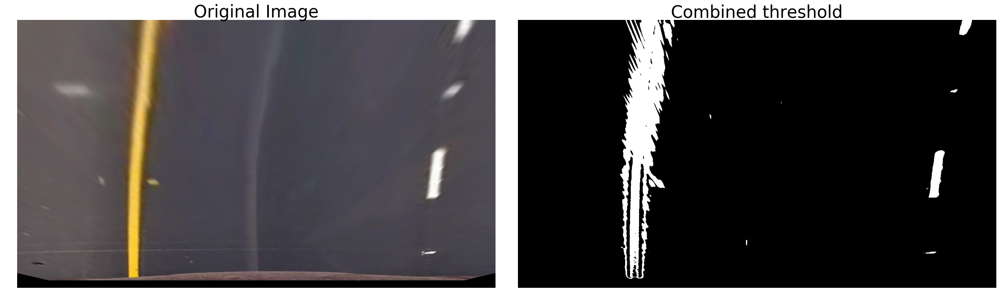

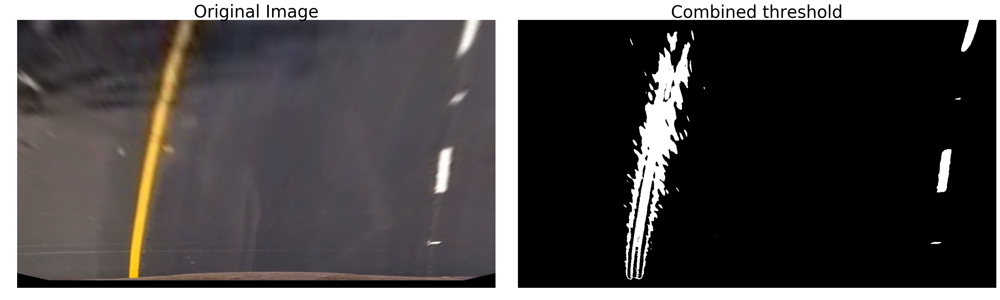

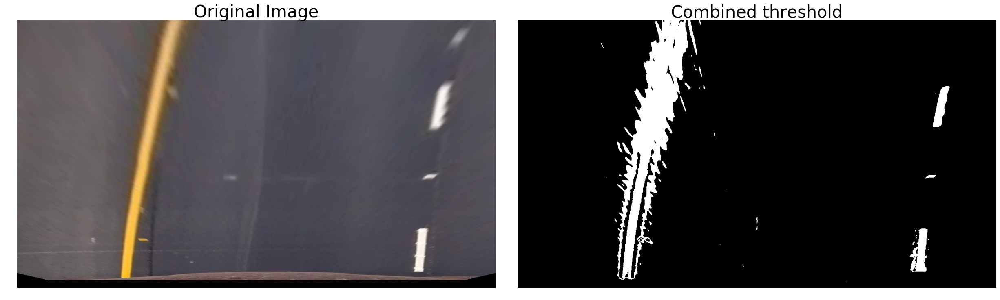

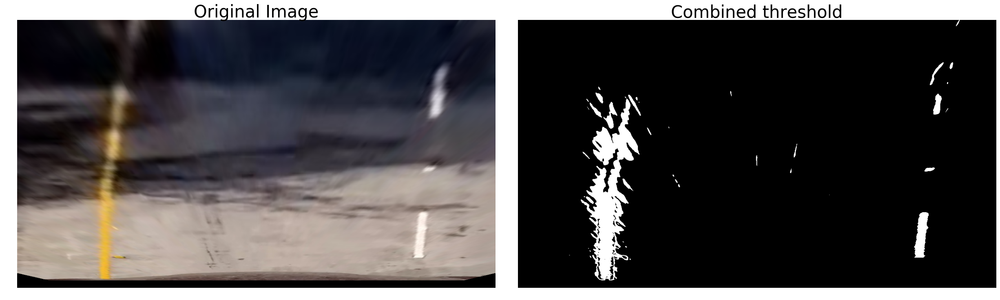

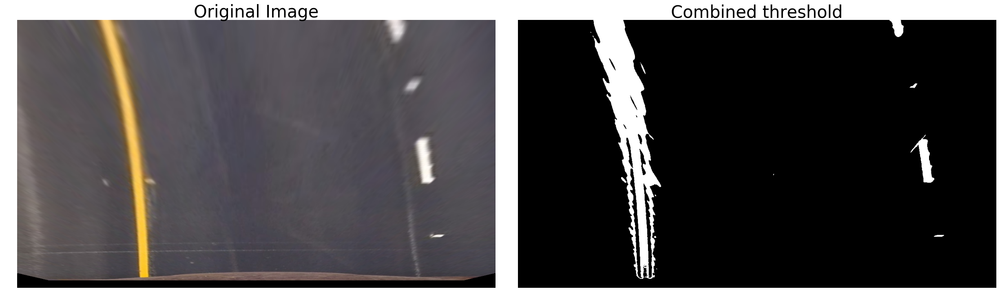

In [14]:
def test_combined_thresholding():
    
    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights=(505, 680)
    factor = 0.75
    M, MI = calc_perspective_matrices(objpoints, imgpoints, "./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, False)

    images = glob.glob('./test_images/test*.jpg')
    for fname in images:
        test_image = cv2.imread(fname)
        undist_image = calc_undistort(test_image, objpoints, imgpoints)
        h, w, d = test_image.shape

        image = cv2.warpPerspective(undist_image, M, (w, h), flags=cv2.INTER_LINEAR)

        hsv_binary = combined_thresholding(image)

        # display the images
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()

        ax1.axis("off")
        ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax1.set_title('Original Image', fontsize=30)

        ax2.axis("off")
        ax2.imshow(hsv_binary, cmap="gray")
        ax2.set_title('Combined threshold', fontsize=30)

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        
test_combined_thresholding()

## 7. Filter noise

In [15]:
# from previous project https://github.com/sosegon/remove-background/blob/master/main.py#L342
from scipy import ndimage as ndi
def remove_spots(binary, spot_size = 100):

    filtered = np.zeros_like(binary)
    
    label_objects, nb_labels = ndi.label(binary)
    sizes = np.bincount(label_objects.ravel())

    mask_sizes = sizes > spot_size
    mask_sizes[0] = 0
    binary = mask_sizes[label_objects]
    
    whites = binary > 0
    
    filtered[whites] = 1
    
    return filtered

### _Test_

/home/sebastian/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:14: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/home/sebastian/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:28: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


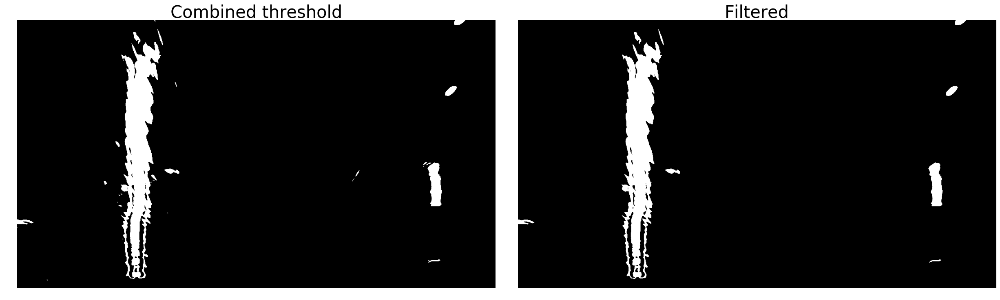

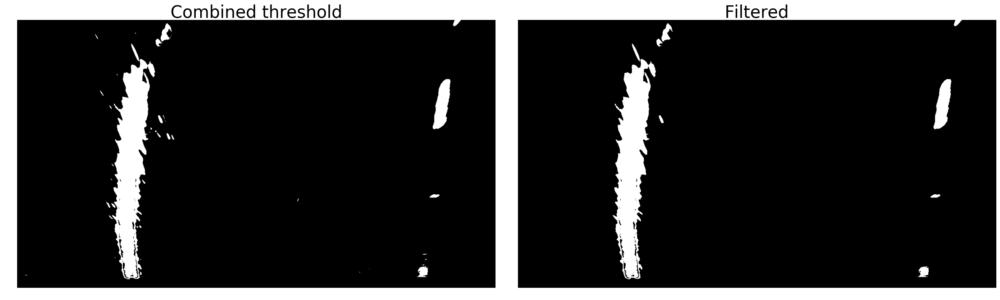

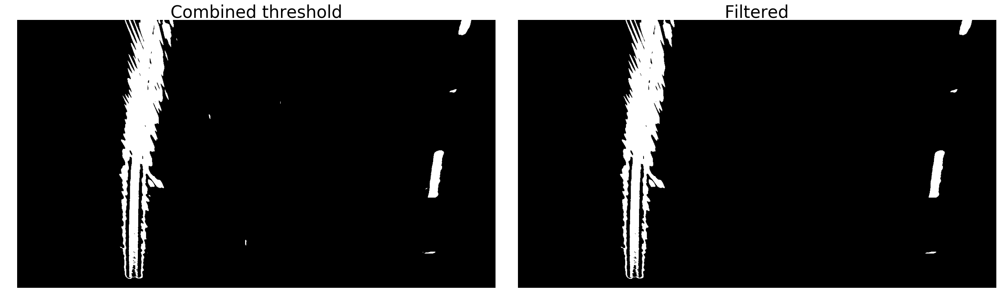

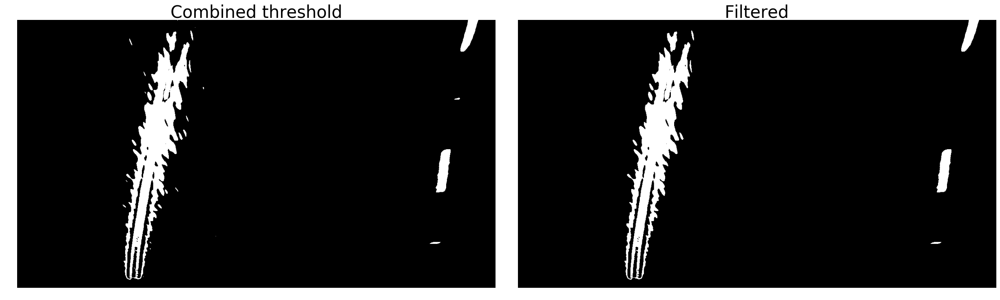

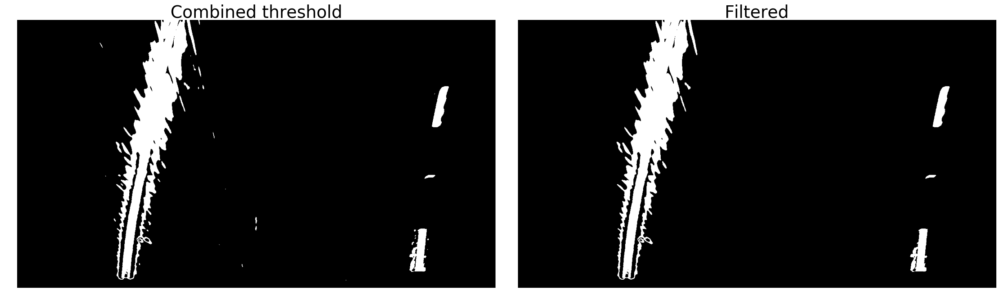

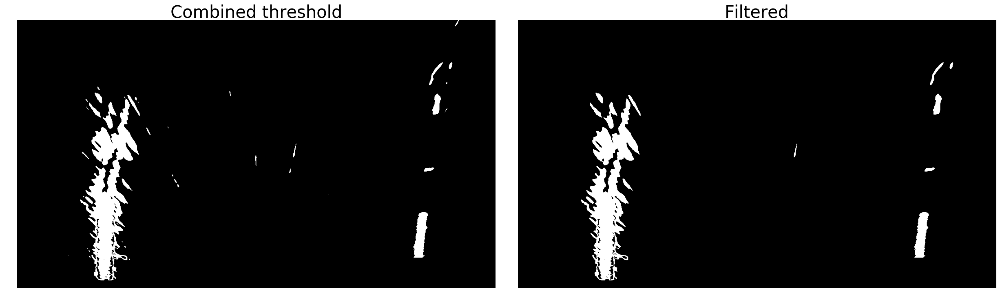

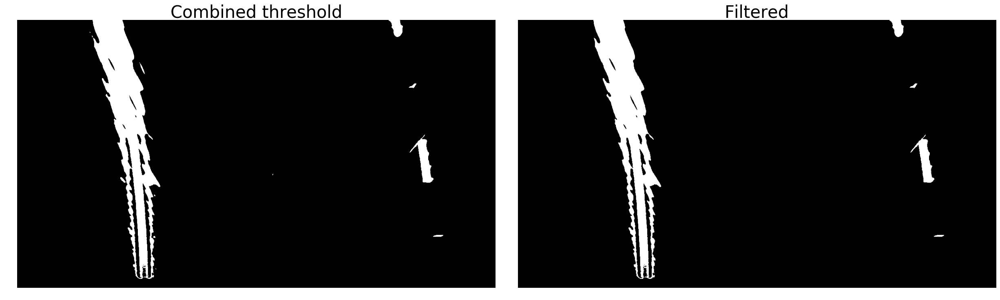

In [16]:
def test_remove_spots():
    
    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights=(505, 680)
    factor = 0.75
    M, MI = calc_perspective_matrices(objpoints, imgpoints, "./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, False)


    images = glob.glob('./test_images/test*.jpg')
    for fname in images:
        test_image = cv2.imread(fname)
        undist_image = calc_undistort(test_image, objpoints, imgpoints)
        h, w, d = test_image.shape

        image = cv2.warpPerspective(undist_image, M, (w, h), flags=cv2.INTER_LINEAR)

        thresholded = combined_thresholding(image)
        filtered = remove_spots(thresholded, 100)

        # display the images
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()

        ax1.axis("off")
        ax1.imshow(thresholded, cmap="gray")
        ax1.set_title('Combined threshold', fontsize=30)

        ax2.axis("off")
        ax2.imshow(filtered, cmap="gray")
        ax2.set_title('Filtered', fontsize=30)

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

test_remove_spots()

## 7. Lines Finding

### 7.1 Raw finding

In [237]:
def find_histogram_peaks(binary):
    # Dimensions of the image
    height, width = binary.shape
    
    # Take a histogram of the bottom half of the image
    histogram = np.sum(
        binary[height / 2:, :], 
        axis = 0
    )

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(width / 2)
    left_x_base = np.argmax(histogram[:midpoint])
    right_x_base = np.argmax(histogram[midpoint:]) + midpoint
    
    return left_x_base, right_x_base, histogram

# Base code from https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/2b62a1c3-e151-4a0e-b6b6-e424fa46ceab/lessons/40ec78ee-fb7c-4b53-94a8-028c5c60b858/concepts/c41a4b6b-9e57-44e6-9df9-7e4e74a1a49a
def find_lines_polynomials(binary_warped, nwindows=9, margin=110, minpix=50, out_image=False):
    
    # Create an output image to draw on and  visualize the result
    if out_image is True:
        out_img = np.dstack((binary_warped, binary_warped, binary_warped)) * 255
    else:
        out_img = None
        
    # Dimensions of the image
    height, width = binary_warped.shape

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    left_x_base, right_x_base, histo = find_histogram_peaks(binary_warped)

    # Choose the number of sliding windows
    # nwindows = 9

    # Set height of windows
    window_height = np.int(height / nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzero_y = np.array(nonzero[0])
    nonzero_x = np.array(nonzero[1])

    # Current positions to be updated for each window
    left_x_current = left_x_base
    right_x_current = right_x_base

    # Set the width of the windows +/- margin
    # margin = 110

    # Set minimum number of pixels found to recenter window
    # minpix = 50

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = height - (window + 1) * window_height
        win_y_high = height - window * window_height

        win_x_left_low = left_x_current - margin
        win_x_left_high = left_x_current + margin

        win_x_right_low = right_x_current - margin
        win_x_right_high = right_x_current + margin

        # Draw the windows on the visualization image
        if out_image is not None:
            cv2.rectangle(
                out_img, 
                (win_x_left_low, win_y_low),
                (win_x_left_high, win_y_high), 
                (0,255, 0), 
                2
            ) 

            cv2.rectangle(
                out_img,
                (win_x_right_low, win_y_low),
                (win_x_right_high, win_y_high),
                (0,255, 0),
                2
            ) 

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = (
            (nonzero_y >= win_y_low) & 
            (nonzero_y < win_y_high) & 
            (nonzero_x >= win_x_left_low) & 
            (nonzero_x < win_x_left_high)).nonzero()[0]

        good_right_inds = (
            (nonzero_y >= win_y_low) & 
            (nonzero_y < win_y_high) & 
            (nonzero_x >= win_x_right_low) & 
            (nonzero_x < win_x_right_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            left_x_current = np.int(np.mean(nonzero_x[good_left_inds]))
        if len(good_right_inds) > minpix:        
            right_x_current = np.int(np.mean(nonzero_x[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    # Extract left and right line pixel positions
    left_x = nonzero_x[left_lane_inds]
    left_y = nonzero_y[left_lane_inds] 
    right_x = nonzero_x[right_lane_inds]
    right_y = nonzero_y[right_lane_inds] 
    
    assert left_x.shape == left_y.shape
    assert right_x.shape == right_y.shape

    # Fit a second order polynomial to each
    left_fit = np.polyfit(left_y, left_x, 2) if len(left_y) != 0 and len(left_x) != 0 else None
    right_fit = np.polyfit(right_y, right_x, 2) if len(right_y) != 0 and len(right_x) != 0 else None
    
    # Set different colors for each lane line
    if out_img is not None:
        out_img[nonzero_y[left_lane_inds], nonzero_x[left_lane_inds]] = [255, 0, 0]
        out_img[nonzero_y[right_lane_inds], nonzero_x[right_lane_inds]] = [0, 0, 255]
        
    # x and y fitted 
    fity = np.linspace(0, height - 1, height)
    if left_fit is not None:
        l_A, l_B, l_C = left_fit[0], left_fit[1], left_fit[2]
        fit_left_x = (l_A * fity**2) + (l_B * fity) + (l_C)
    else:
        fit_left_x = None

    if right_fit is not None:
        r_A, r_B, r_C = right_fit[0], right_fit[1], right_fit[2]
        fit_right_x = (r_A * fity**2) + (r_B * fity) + (r_C)
    else:
        fit_right_x = None

    return left_fit, right_fit, left_x, right_x, left_y, right_y, fit_left_x, fit_right_x, out_img

### _Test_

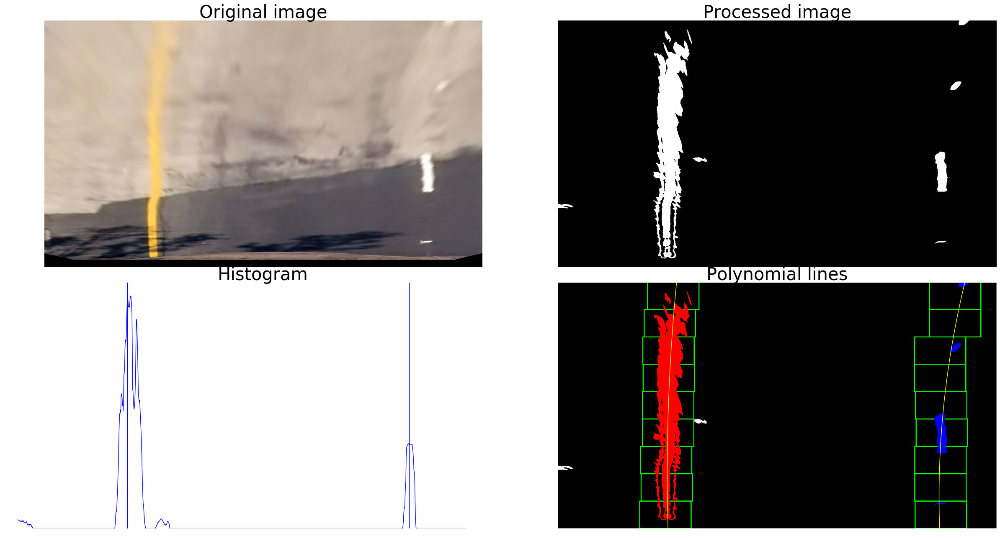

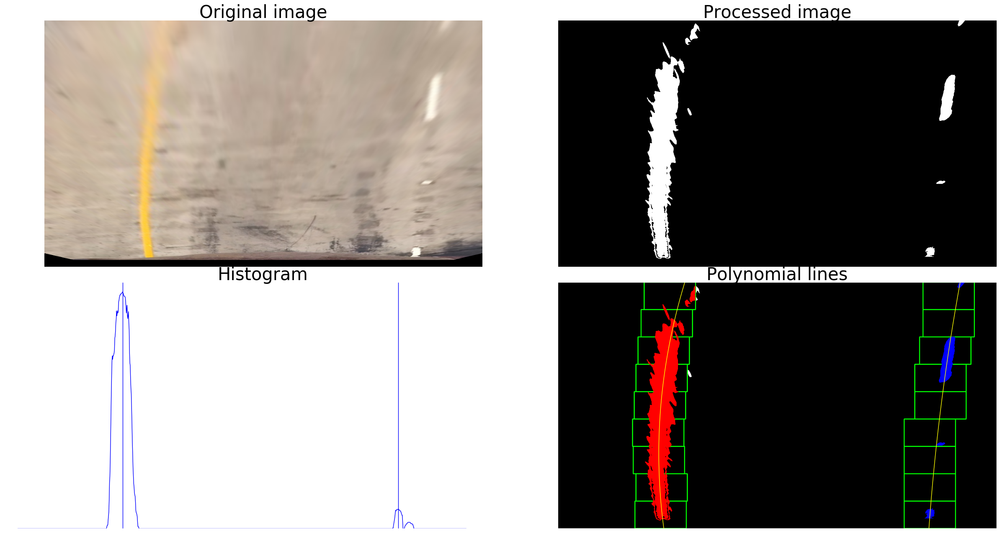

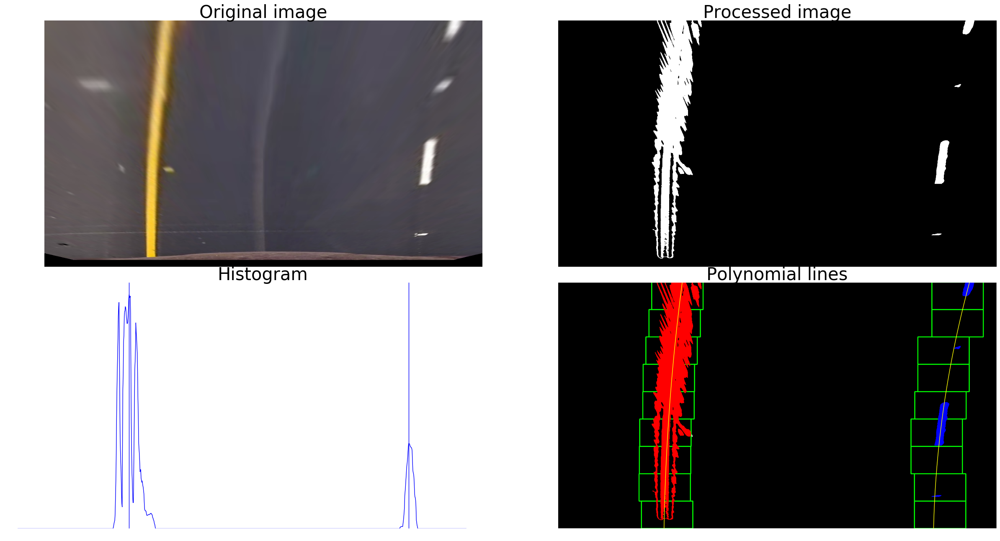

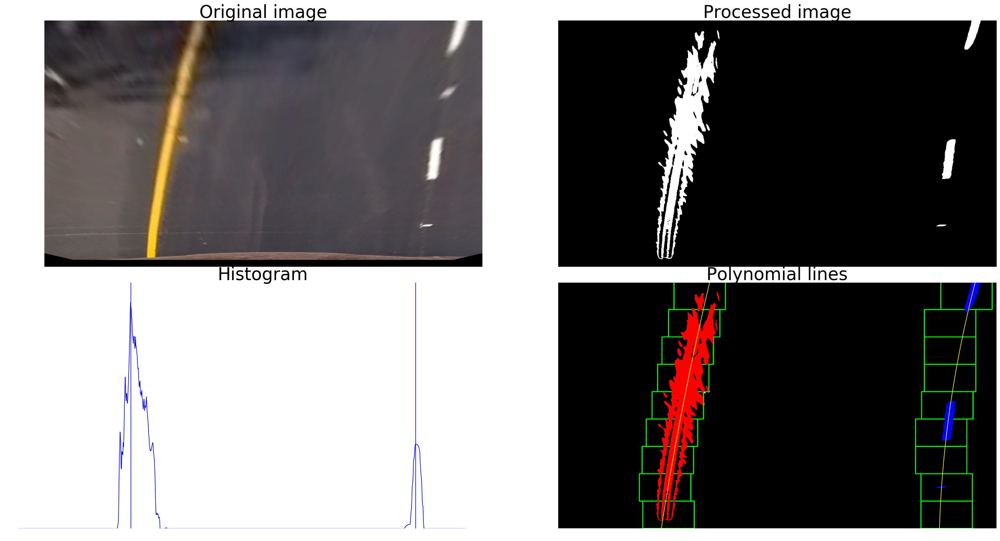

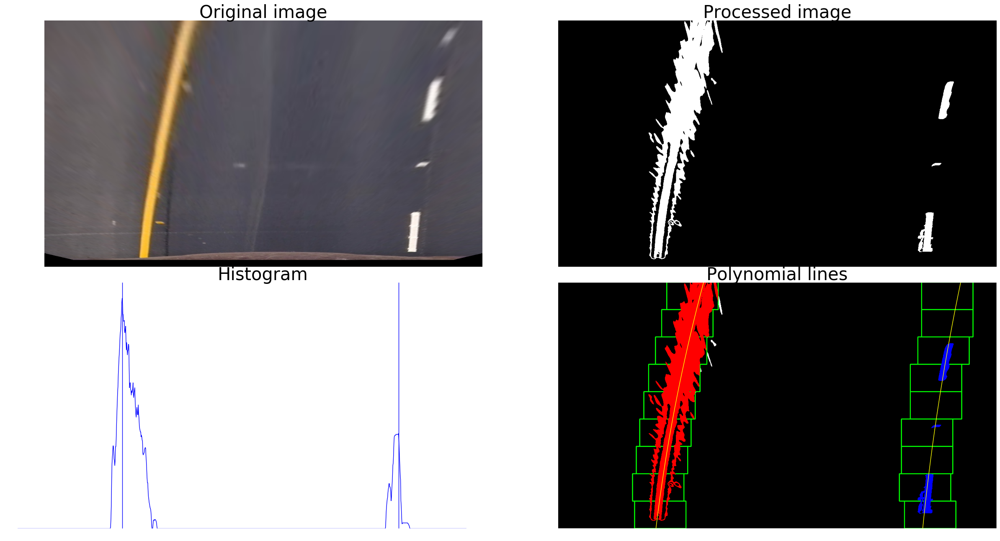

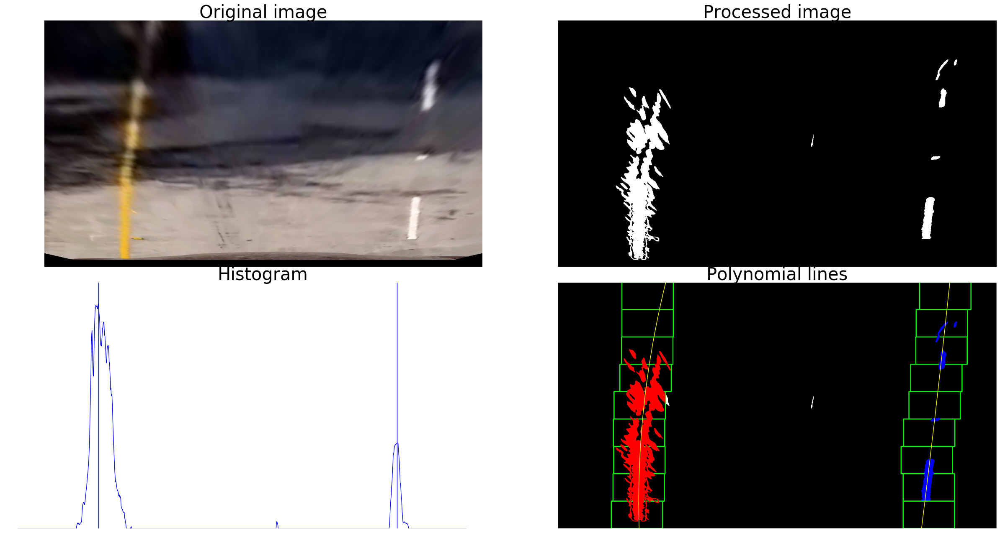

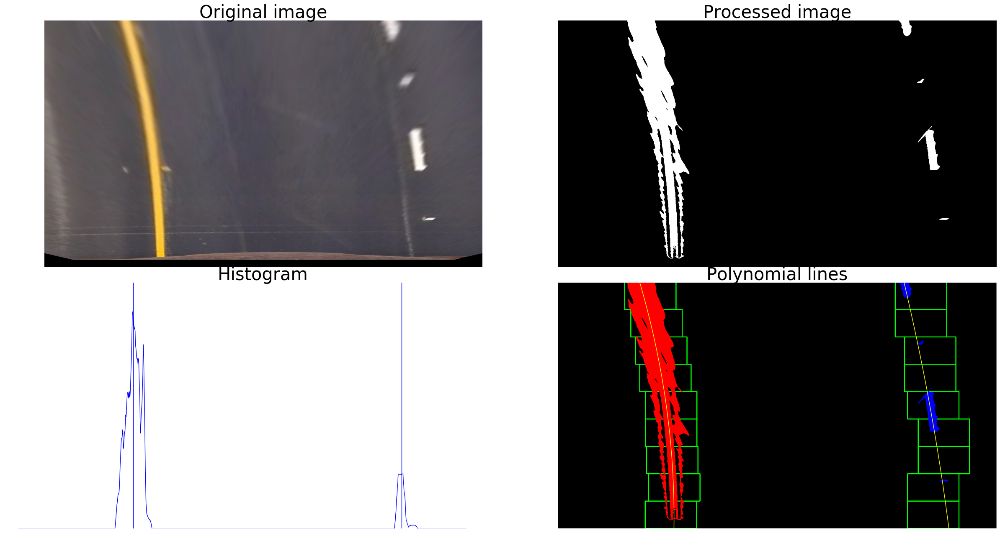

In [238]:
def test_find_lines_polynomials():
    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights=(505, 680)
    factor = 0.75
    M, MI = calc_perspective_matrices(objpoints, imgpoints, "./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, False)
    
    images = glob.glob('./test_images/test*.jpg')
    
    for fname in images:
        test_image_ = cv2.imread(fname)
        h, w, d = test_image_.shape
        image_size_ = (w, h)
        
        undist_image_ = calc_undistort(test_image_, objpoints, imgpoints)
        warped_image_ = cv2.warpPerspective(undist_image_, M, image_size_, flags=cv2.INTER_LINEAR)
        thresholded_image_ = combined_thresholding(warped_image_)
        filtered_image_ = remove_spots(thresholded_image_, 100)
        lx, rx, histo = find_histogram_peaks(filtered_image_)
        
        ########################################################
        # Find polynomials
        ########################################################
        left_fit, right_fit, left_x, right_x, left_y, right_y, fit_left_x, fit_right_x, polynomials_image_ = find_lines_polynomials(filtered_image_, out_image=True, margin=75)

        # Generate x and y values for plotting
        fit_y = np.linspace(0, polynomials_image_.shape[0] - 1, polynomials_image_.shape[0])

        # display the images
        f, (ax1, ax2) = plt.subplots(2, 2, figsize=(24, 13.5))
        f.tight_layout()

        ax1[0].axis("off")
        ax1[0].imshow(cv2.cvtColor(warped_image_, cv2.COLOR_BGR2RGB))
        ax1[0].set_title('Original image', fontsize=30)
        
        ax1[1].axis("off")
        ax1[1].imshow(filtered_image_, cmap="gray")
        ax1[1].set_title('Processed image', fontsize=30)

        ax2[0].axis("off")
        ax2[0].plot(histo)
        ax2[0].axvline(x=lx)
        ax2[0].axvline(x=rx)
        ax2[0].set_title('Histogram', fontsize=30)
        
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        
        ax2[1].axis("off")
        ax2[1].imshow(polynomials_image_)
        ax2[1].set_title('Polynomial lines', fontsize=30)
        
        ax2[1].plot(fit_left_x, fit_y, color='yellow')
        ax2[1].plot(fit_right_x, fit_y, color='yellow')
        
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

        plt.xlim(0, 1280)
        plt.ylim(720, 0)

test_find_lines_polynomials()

### 7.2 With previous polynomials

In [239]:
# Base code from https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/2b62a1c3-e151-4a0e-b6b6-e424fa46ceab/lessons/40ec78ee-fb7c-4b53-94a8-028c5c60b858/concepts/c41a4b6b-9e57-44e6-9df9-7e4e74a1a49a
def find_lines_polynomials_with_previous(binary_warped, left_fit, right_fit, margin=100, out_image=False):
    nonzero = binary_warped.nonzero()
    nonzero_y = np.array(nonzero[0]) # non zero y
    nonzero_x = np.array(nonzero[1]) # non zero x

    height, width = binary_warped.shape
    # polynomials coefficients
    l_A, l_B, l_C = left_fit[0], left_fit[1], left_fit[2]
    r_A, r_B, r_C = right_fit[0], right_fit[1], right_fit[2]
    
    left_fit_values = (l_A * nonzero_y**2) + (l_B * nonzero_y) + (l_C)
    right_fit_values = (r_A * nonzero_y**2) + (r_B * nonzero_y) + (r_C)

    left_lane_inds = (
        (nonzero_x > (left_fit_values - margin)) & 
        (nonzero_x < (left_fit_values + margin))
    ) 
    right_lane_inds = (
        (nonzero_x > (right_fit_values - margin)) & 
        (nonzero_x < (right_fit_values + margin))
    )

    # Extract left and right line pixel positions
    left_x = nonzero_x[left_lane_inds]
    left_y = nonzero_y[left_lane_inds] 
    right_x = nonzero_x[right_lane_inds]
    right_y = nonzero_y[right_lane_inds]
    
    assert left_x.shape == left_y.shape
    assert right_x.shape == right_y.shape
    
    # Fit a second order polynomial to each
    left_fit2 = np.polyfit(left_y, left_x, 2) if len(left_y) != 0 and len(left_x) != 0 else None
    right_fit2 = np.polyfit(right_y, right_x, 2) if len(right_y) != 0 and len(right_x) != 0 else None
    
     # Generate x and y values for plotting
    fit_y = np.linspace(0, height - 1, height)
    fit_left_x = (l_A * fit_y**2) + (l_B * fit_y) + (l_C)
    fit_right_x = (r_A * fit_y**2) + (r_B * fit_y) + (r_C)
    
    if out_image is True:
        # Create an image to draw on and an image to show the selection window
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        window_img = np.zeros_like(out_img)

        # Color in left and right line pixels
        out_img[nonzero_y[left_lane_inds], nonzero_x[left_lane_inds]] = [255, 0, 0]
        out_img[nonzero_y[right_lane_inds], nonzero_x[right_lane_inds]] = [0, 0, 255]

        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([fit_left_x - margin, fit_y]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([fit_left_x + margin, fit_y])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        
        right_line_window1 = np.array([np.transpose(np.vstack([fit_right_x - margin, fit_y]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([fit_right_x + margin, fit_y])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    else:
        result = None

    return left_fit2, right_fit2, left_x, right_x, left_y, right_y, fit_left_x, fit_right_x, result

### _Test_

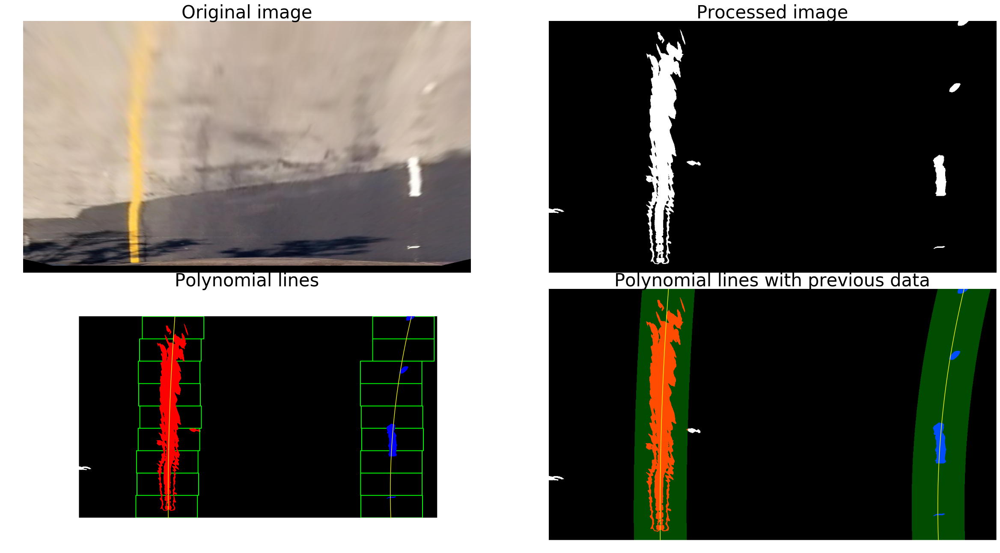

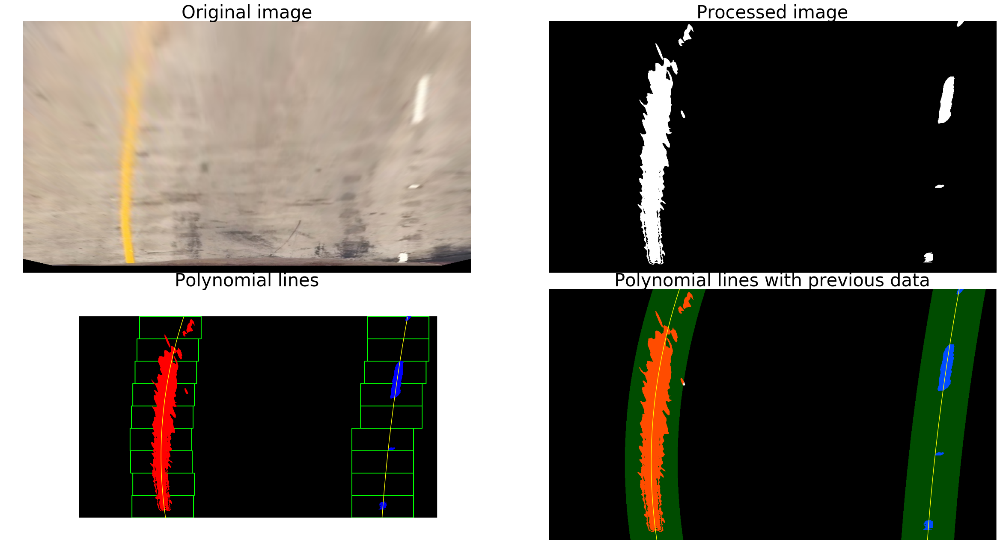

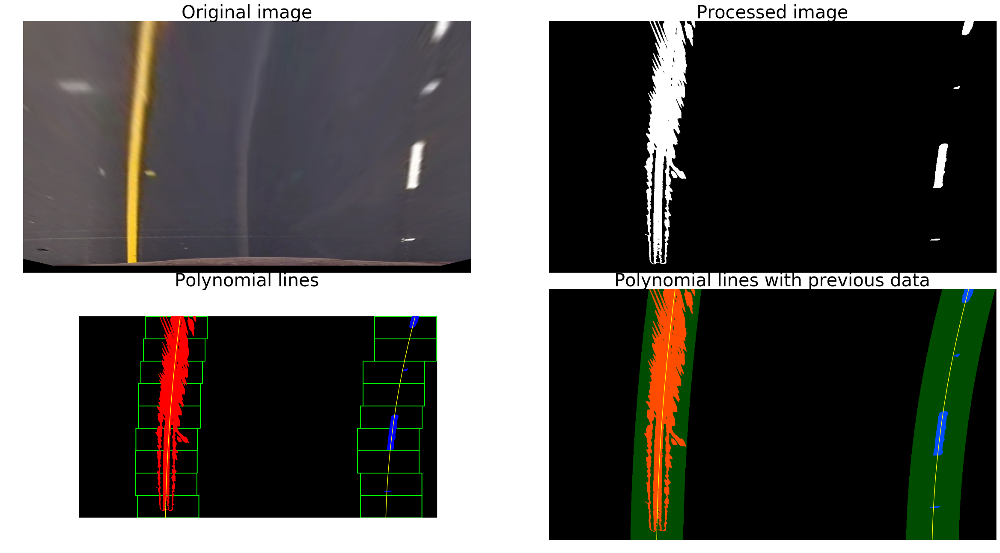

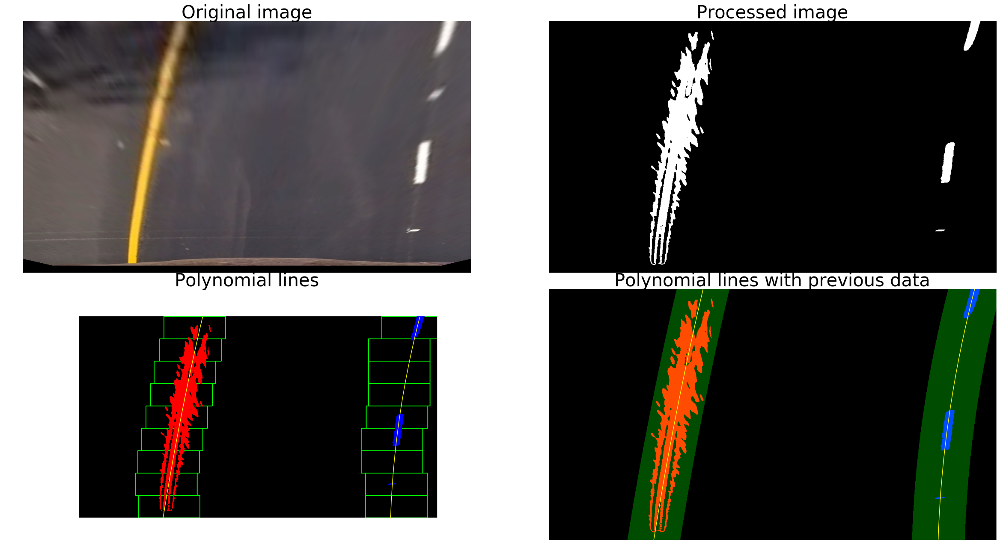

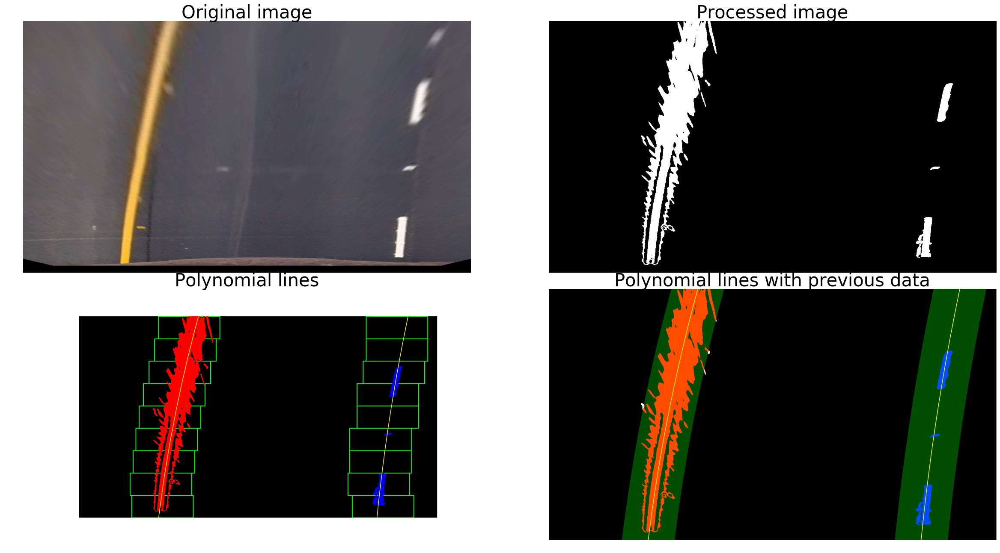

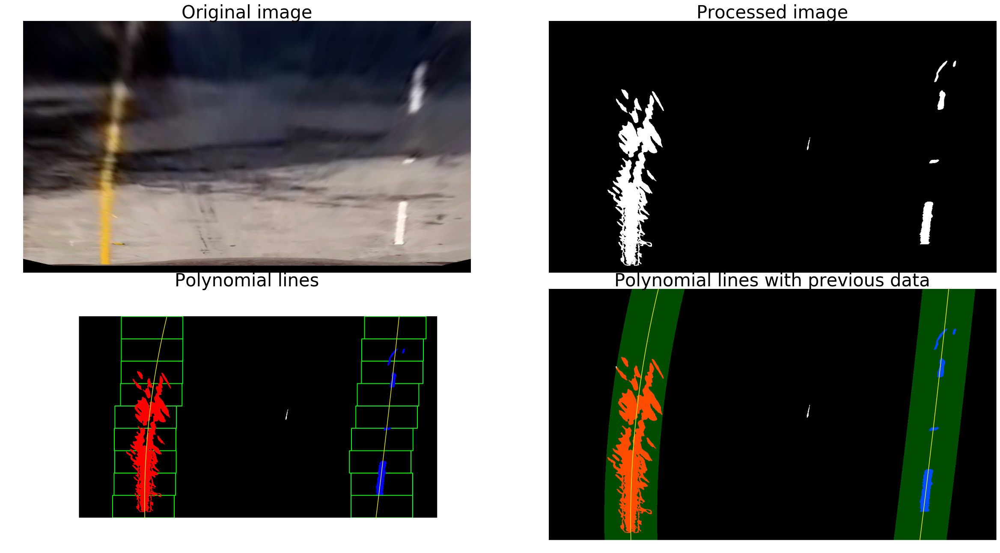

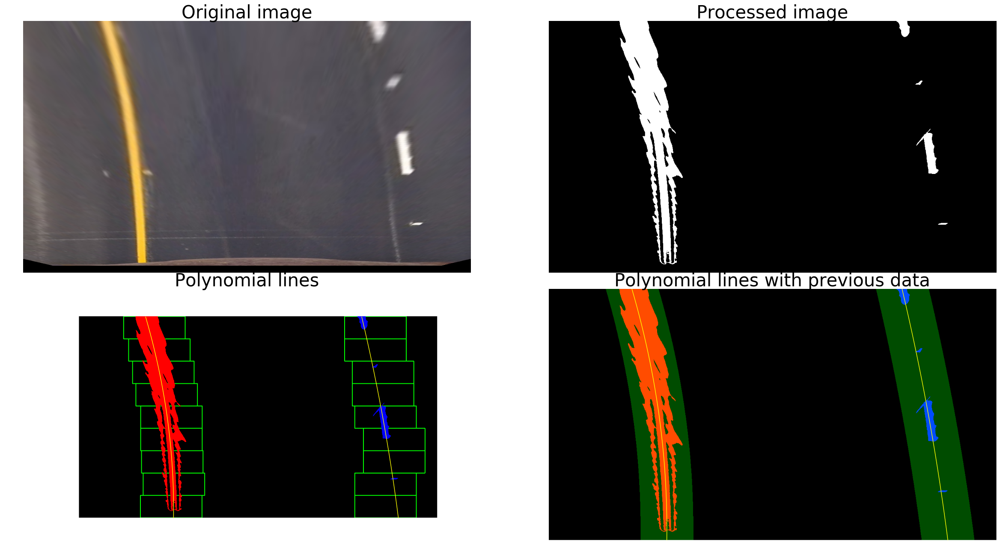

In [240]:
def test_find_lines_polynomials_with_previous():
    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights=(505, 680)
    factor = 0.75
    margin = 75
    
    M, MI = calc_perspective_matrices(objpoints, imgpoints, "./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, False)
    
    images = glob.glob('./test_images/test*.jpg')
    
    for fname in images:
        test_image_ = cv2.imread(fname)
        h, w, d = test_image_.shape
        image_size_ = (w, h)
        
        undist_image_ = calc_undistort(test_image_, objpoints, imgpoints)
        warped_image_ = cv2.warpPerspective(undist_image_, M, image_size_, flags=cv2.INTER_LINEAR)
        thresholded_image_ = combined_thresholding(warped_image_)
        filtered_image_ = remove_spots(thresholded_image_, 100)
        lx, rx, histo = find_histogram_peaks(filtered_image_)
        
        ########################################################
        # Find polynomials
        ########################################################
        left_fit, right_fit, left_x, right_x, left_y, right_y, fit_left_x, right_left_x, polynomials_image_ = find_lines_polynomials(filtered_image_, out_image=True)

        # Generate x and y values for plotting
        fit_y = np.linspace(0, polynomials_image_.shape[0] - 1, polynomials_image_.shape[0])
        
        ########################################################
        # Find polynomials with previous polynomials
        ########################################################
        
        left_fit2, right_fit2, left_x2, right_x2, left_y2, right_y2, fit_left_x2, fit_right_x2, polynomials_image2_ = find_lines_polynomials_with_previous(filtered_image_, left_fit, right_fit, margin, out_image=True)

        # Generate x and y values for plotting
        fit_y = np.linspace(0, polynomials_image2_.shape[0] - 1, polynomials_image2_.shape[0])

        # display the images
        f, (ax1, ax2) = plt.subplots(2, 2, figsize=(24, 13.5))
        f.tight_layout()

        ax1[0].axis("off")
        ax1[0].imshow(cv2.cvtColor(warped_image_, cv2.COLOR_BGR2RGB))
        ax1[0].set_title('Original image', fontsize=30)
        
        ax1[1].axis("off")
        ax1[1].imshow(filtered_image_, cmap="gray")
        ax1[1].set_title('Processed image', fontsize=30)

        ax2[0].axis("off")
        ax2[0].imshow(polynomials_image_)
        ax2[0].set_title('Polynomial lines', fontsize=30)
        ax2[0].plot(fit_left_x2, fit_y, color='yellow')
        ax2[0].plot(fit_right_x2, fit_y, color='yellow')
        
        ax2[1].axis("off")
        ax2[1].imshow(polynomials_image2_)
        ax2[1].set_title('Polynomial lines with previous data', fontsize=30)
        ax2[1].plot(fit_left_x2, fit_y, color='yellow')
        ax2[1].plot(fit_right_x2, fit_y, color='yellow')
        
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

        plt.xlim(0, 1280)
        plt.ylim(720, 0)

test_find_lines_polynomials_with_previous()

## 8. Curvature and Lane Center Offser Measuring

In [241]:
def calc_radius(line_fit, offset_start):
    # Generate some fake data to represent lane-line pixels
    ploty = np.linspace(0, 719, num=720)# to cover same y-range as image
    
    # polynomials coefficients
    l_A, l_B, l_C = line_fit[0], line_fit[1], line_fit[2]
    
    # For each y position generate random x position within +/-50 pix
    # of the line base position in each case (x=200 for line, and x=900 for right)
    linex = np.array([offset_start + (y**2)*l_A + np.random.randint(-50, high=51) 
                                  for y in ploty])
    
    linex = linex[::-1]  # Reverse to match top-to-bottom in y

    # Fit a second order polynomial to pixel positions in each fake lane line
    line_fit = np.polyfit(ploty, linex, 2)
        
    # polynomials coefficients
    l_A, l_B, l_C = line_fit[0], line_fit[1], line_fit[2]
    
    line_fitx = (l_A * ploty**2) + (l_B * ploty) + (l_C)

    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    line_curverad = ((1 + (2 * l_A * y_eval + l_B)**2)**1.5) / np.absolute(2 * l_A)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    line_fit_cr = np.polyfit(ploty * ym_per_pix, linex * xm_per_pix, 2)
    
    # Calculate the new radius of curvature
    # polynomials coefficients
    l_A, l_B, l_C = line_fit_cr[0], line_fit_cr[1], line_fit_cr[2]
    
    line_curverad = ((1 + (2 * l_A * y_eval + l_B)**2)**1.5) / np.absolute(2 * l_A)
    
    return line_curverad

def calc_offset(left_fit, right_fit):
    y = 719
    
    # polynomials coefficients
    l_A, l_B, l_C = left_fit[0], left_fit[1], left_fit[2]
    
    x1 = (l_A * y**2) + (l_B * y) + (l_C)
    
    
    # polynomials coefficients
    l_A, l_B, l_C = right_fit[0], right_fit[1], right_fit[2]
    
    x2 = (l_A * y**2) + (l_B * y) + (l_C)
    
    mid = (x1 + x2) / 2
    
    offset = (1280 / 2) - mid
    
    m_per_pix = 3.7/700 # meters per pixel in x dimension
    
    return offset * m_per_pix


### _Test_

[  5.88008538e-05  -7.50679263e-02   3.42895553e+02]
[  1.91481104e-04  -2.39834775e-01   1.18823651e+03]
[  3.27838704e-04  -3.25984258e-01   3.74403291e+02]
[  7.73746128e-05  -1.82305462e-01   1.17460233e+03]
[  7.76002642e-05  -1.29302661e-01   3.61927129e+02]
[  1.70874041e-04  -2.68440395e-01   1.20179571e+03]
[  5.19923337e-05  -2.33605349e-01   4.41878649e+02]
[  1.57358910e-04  -2.58167221e-01   1.21849027e+03]
[  1.03244731e-04  -2.71175971e-01   4.26481192e+02]
[  7.54781257e-05  -2.08194101e-01   1.17603806e+03]
[  1.81634345e-04  -2.39808310e-01   3.13859079e+02]
[ -1.32724188e-05  -1.05210665e-01   1.14442799e+03]
[ -2.12335293e-04   2.91387227e-01   2.38291807e+02]
[ -7.52513890e-05   2.36013561e-01   1.01099741e+03]
std left radius: 468.59441
std right radius: 1010.73056


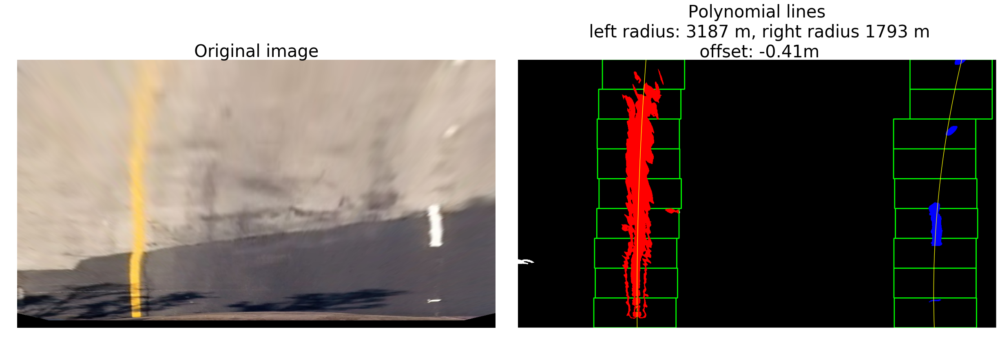

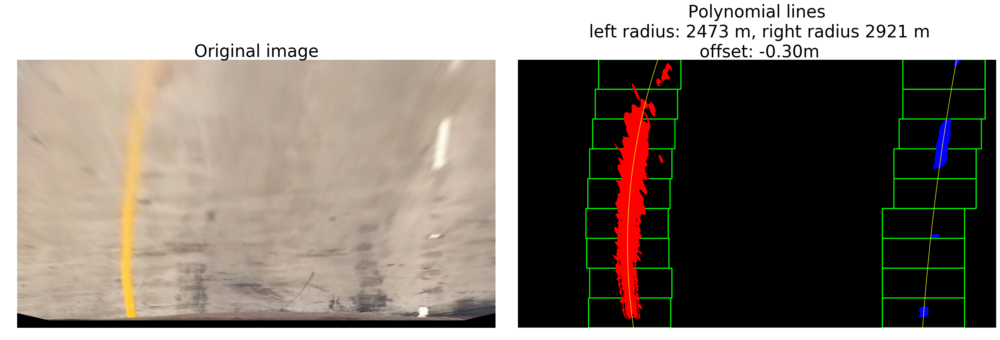

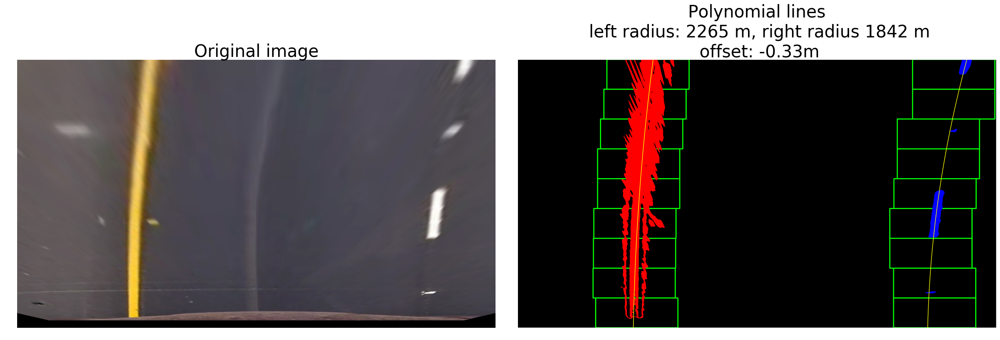

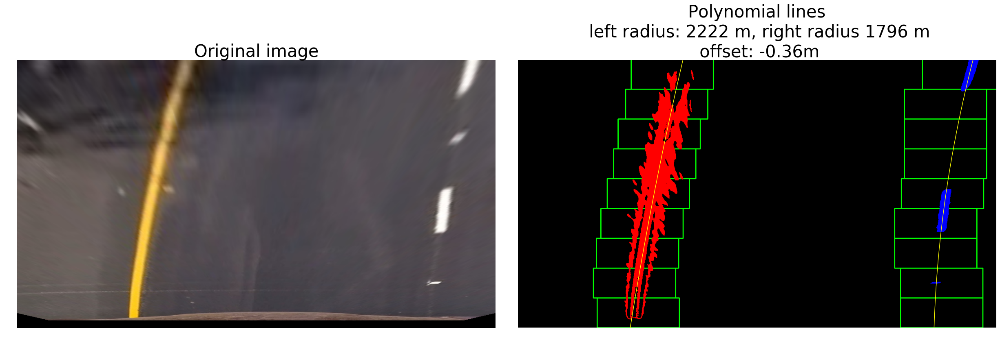

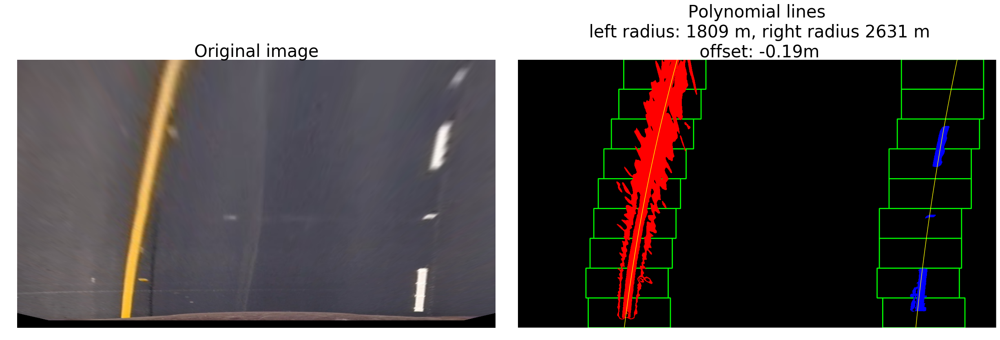

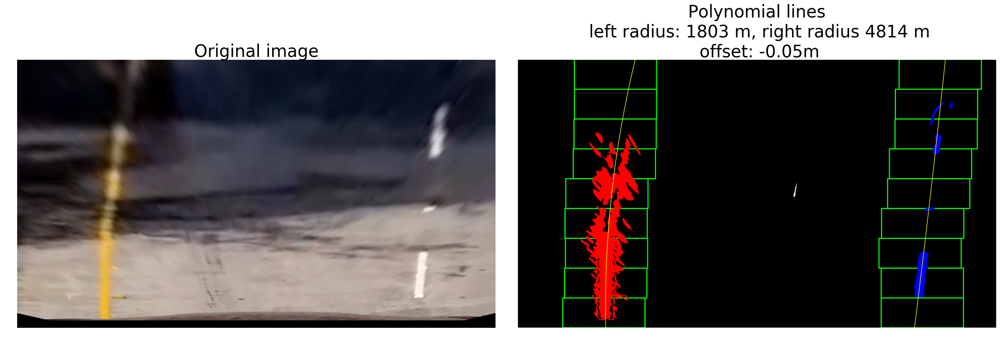

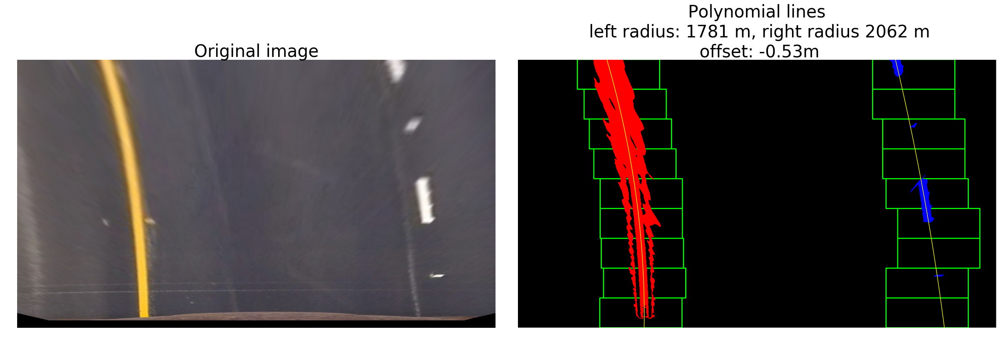

In [242]:
def test_calc_radius_offset():
    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights=(505, 680)
    factor = 0.75
    M, MI = calc_perspective_matrices(objpoints, imgpoints, "./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, False)
    
    images = glob.glob('./test_images/test*.jpg')
    
    left_fits, right_fits = [], []
    for fname in images:
        test_image_ = cv2.imread(fname)
        h, w, d = test_image_.shape
        image_size_ = (w, h)
        
        undist_image_ = calc_undistort(test_image_, objpoints, imgpoints)
        warped_image_ = cv2.warpPerspective(undist_image_, M, image_size_, flags=cv2.INTER_LINEAR)
        thresholded_image_ = combined_thresholding(warped_image_)
        filtered_image_ = remove_spots(thresholded_image_, 100)
        lx, rx, histo = find_histogram_peaks(filtered_image_)
        
        ########################################################
        # Find polynomials
        ########################################################
        left_fit, right_fit, left_x, right_x, left_y, right_y, fit_left_x, fit_right_x, polynomials_image_ = find_lines_polynomials(filtered_image_, out_image=True)
        l_rad, r_rad = calc_radius(left_fit, 200), calc_radius(right_fit, 900)
        offset = calc_offset(left_fit, right_fit)

        # polynomials coefficients
        l_A, l_B, l_C = left_fit[0], left_fit[1], left_fit[2]
        r_A, r_B, r_C = right_fit[0], right_fit[1], right_fit[2]

        # Generate x and y values for plotting
        fity = np.linspace(0, polynomials_image_.shape[0] - 1, polynomials_image_.shape[0])
        fit_leftx = (l_A * fity**2) + (l_B * fity) + (l_C)
        fit_rightx = (r_A * fity**2) + (r_B * fity) + (r_C)

        # display the images
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 13.5))
        f.tight_layout()

        ax1.axis("off")
        ax1.imshow(cv2.cvtColor(warped_image_, cv2.COLOR_BGR2RGB))
        ax1.set_title('Original image', fontsize=30)
     
        ax2.axis("off")
        ax2.imshow(polynomials_image_)
        ax2.set_title('Polynomial lines\n left radius: {:.0f} m, right radius {:.0f} m\n offset: {:.2f}m'.format(l_rad, r_rad, offset), fontsize=30)
        ax2.plot(fit_leftx, fity, color='yellow')
        ax2.plot(fit_rightx, fity, color='yellow')
        
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        
        left_fits.append(l_rad)
        right_fits.append(r_rad)
        
        print(left_fit)
        print(right_fit)

    left_fits = np.array(left_fits)
    right_fits = np.array(right_fits)
    
    left_std_A = np.std(left_fits)
    right_std_A = np.std(right_fits)
    
    print("std left radius: {:.5f}".format(left_std_A))
    print("std right radius: {:.5f}".format(right_std_A))
    
test_calc_radius_offset()

## 9. Final Pipeline

In [247]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        #############################################
        self.detected = False
        
        # x values of the last n fits of the line
        #############################################
        self.current_x = np.array([])
        
        #average x values of the fitted line over the last n iterations
        self.average_x = np.array([])
        
        #polynomial coefficients averaged over the last n iterations
        self.average_fit = np.array([])
        
        #polynomial coefficients for the most recent fit
        #############################################
        self.current_fit = np.array([])

        #radius of curvature of the line in some units
        #############################################
        self.radius_of_curvature = None 
        
        #distance in meters of vehicle center from the line
        #############################################
        self.lane_offset = None 
        
        #difference in fit coefficients between last and new fits
        #############################################
        self.diffs = np.array([0,0,0], dtype='float') 
        
        #x values for detected line pixels
        #############################################
        self.all_x = np.array([])  
        
        #y values for detected line pixels
        #############################################
        self.all_y = np.array([])

#############################################
# average x, average fit, average radius, radius std, average offset
#############################################
def create_values(lines):
    x = []

    A = []
    B = []
    C = []

    radius = []

    offset = []

    for line in lines:
        x.append(line.current_x)

        fit = line.current_fit
        A.append(fit[0])
        B.append(fit[1])
        C.append(fit[2])

        radius.append(line.radius_of_curvature)

        offset.append(line.lane_offset)

    avg_x = np.average(x, axis=0)
    
    A = np.array(A)
    B = np.array(B)
    C = np.array(C)
    avg_fit = np.array([np.average(A), np.average(B), np.average(C)])

    radius = np.array(radius)
    avg_rad = np.average(radius)

    std_rad = np.std(radius)

    offset = np.array(offset)
    avg_off = np.average(offset)
    
    return avg_x, avg_fit, avg_rad, std_rad, avg_off

def create_undetected_line(avg_x, avg_fit, avg_rad, std_rad, avg_off):

    new_line = Line()

    new_line.detected = False

    new_line.current_x = new_line.average_x = avg_x
    
    new_line.average_fit = new_line.current_fit = avg_fit
    
    new_line.radius_of_curvature = avg_rad

    new_line.lane_offset = avg_off

    # new_line.diffs are zero since current_fit and average_fit are the same

    # new_line.all_x Empty since line were not detected

    # new_line.all_y idem

    return new_line

def create_detected_line(x_fitted, avg_x, fit, avg_fit, x, y, line_offset):
    
    new_line = Line()
    
    new_line.detected = True
    
    new_line.current_x = x_fitted
    
    new_line.average_x = avg_x
    
    new_line.current_fit = fit
    
    new_line.average_fit = avg_fit
    
    new_line.radius_of_curvature = calc_radius(fit, line_offset)
    
    # new_line.lane_offset calculated with both lines
    
    new_line.diffs = fit - avg_fit if avg_fit is not None else new_line.diffs
    
    new_line.all_x = x
    
    new_line.all_y = y

    return new_line

def create_lines(detect, avg_x, avg_fit, avg_rad, std_rad, avg_off, fit, x, y, x_fitted):

    l_detec, r_detec = detect[0], detect[1]
    l_avg_x, r_avg_x = avg_x[0], avg_x[1]
    l_avg_ft, r_avg_ft = avg_fit[0], avg_fit[1]
    l_avg_rd, r_avg_rd = avg_rad[0], avg_rad[1]
    l_std_rd, r_std_rd = std_rad[0], std_rad[1]
    l_avg_of, r_avg_of = avg_off[0], avg_off[1]

    l_fit, r_fit = fit[0], fit[1]
    l_x_fitted, r_x_fitted = x_fitted[0], x_fitted[1]
    l_x, r_x = x[0], x[1]
    l_y, r_y = y[0], y[1]


    if l_detec is False and r_detec is False: # None line detected
        l_lin_nw = create_undetected_line(l_avg_x, l_avg_ft, l_avg_rd, l_std_rd, l_avg_of)
        r_lin_nw = create_undetected_line(r_avg_x, r_avg_ft, r_avg_rd, r_std_rd, r_avg_of)
    
    elif l_detec is True and r_detec is False:
        l_lin_nw = create_detected_line(l_x_fitted, l_avg_x, l_fit, l_avg_ft, l_x, l_y, 200)
        r_lin_nw = create_undetected_line(r_avg_x, r_avg_ft, r_avg_rd, r_std_rd, r_avg_of)
        l_lin_nw.lane_offset = r_lin_nw.lane_offset = calc_offset(l_lin_nw.current_fit, r_lin_nw.current_fit)

    elif l_detec is False and r_detec is True:
        l_lin_nw = create_undetected_line(l_avg_x, l_avg_ft, l_avg_rd, l_std_rd, l_avg_of)
        r_lin_nw = create_detected_line(r_x_fitted, r_avg_x, r_fit, r_avg_ft, r_x, r_y, 900)
        l_lin_nw.lane_offset = r_lin_nw.lane_offset = calc_offset(l_lin_nw.current_fit, r_lin_nw.current_fit)

    else:
        r_lin_nw = create_detected_line(r_x_fitted, r_avg_x, r_fit, r_avg_ft, r_x, r_y, 900)
        l_lin_nw = create_detected_line(l_x_fitted, l_avg_x, l_fit, l_avg_ft, l_x, l_y, 200)
        l_lin_nw.lane_offset = r_lin_nw.lane_offset = calc_offset(l_lin_nw.current_fit, r_lin_nw.current_fit)

    return l_lin_nw, r_lin_nw

def correct_lines(left_line, right_line, arg_max_left, arg_max_right, histo, height, parallel_thresh=25, parallel_dist=800):
    # determine which line is stronger
    is_left_stronger = histo[arg_max_left] >= histo[arg_max_right]

    # compare how parallel are the lines
    avg_distance = np.abs(np.average(left_line.current_x - right_line.current_x))

    left_corrected, right_corrected = False, False
    thresh = (parallel_dist - parallel_thresh, parallel_dist + parallel_thresh)
    
    l_A = left_line.current_fit[0]
    r_A = right_line.current_fit[0]
    
    same_direction = l_A * r_A > 0

    if is_left_stronger:
        if avg_distance <= thresh[0] or avg_distance >= thresh[1] or same_direction == False: # fix right
            correct_parallel_line(right_line, left_line, height, parallel_dist, 900)
            right_corrected = True
    else:
        if avg_distance <= thresh[0] or avg_distance >= thresh[1] or same_direction == False: # fix left
            correct_parallel_line(left_line, right_line, height, parallel_dist, 200)
            left_corrected = True

    return left_corrected, right_corrected

def correct_parallel_line(line_to_fix, line_good, height, parallel_dist, line_offset):
    x_fixed = line_good.all_x + parallel_dist
    y_fixed = line_good.all_y

    fit_fixed = np.polyfit(y_fixed, x_fixed, 2)

    fit_y = np.linspace(0, height - 1, height)
    l_A, l_B, l_C = fit_fixed[0], fit_fixed[1], fit_fixed[2]
    fit_x = (l_A * fit_y**2) + (l_B * fit_y) + (l_C)

    line_to_fix.current_x = fit_x
    line_to_fix.current_fit = fit_fixed
    line_to_fix.radius_of_curvature = calc_radius(fit_fixed, line_offset)
    line_to_fix.lane_offset = line_good.lane_offset = calc_offset(line_to_fix.current_fit, line_good.current_fit)
    
    fit = fit_fixed
    avg_fit = line_to_fix.average_fit
    line_to_fix.diffs = fit - avg_fit if avg_fit is not None else line_to_fix.diffs

    line_to_fix.all_x = x_fixed
    line_to_fix.all_y = y_fixed


def draw_images(left_line_new, right_line_new, im_filter, im_undist, MI, dims=(720, 1280)):

    fit_y = np.linspace(0, dims[0] - 1, dims[0])
    fit_left_x = left_line_new.current_x
    fit_right_x = right_line_new.current_x

    ################################################################################################################
    # Draw lane
    ################################################################################################################

    warp_zero = np.zeros(dims).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([fit_left_x, fit_y]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([fit_right_x, fit_y])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv) 
    new_warp = cv2.warpPerspective(color_warp, MI, (1280, 720))

    # Combine the result with the original image
    im_undist_with_lane = cv2.addWeighted(im_undist, 1, new_warp, 0.3, 0)
        
    ################################################################################################################
    # Draw histogram
    ################################################################################################################
    
    out_img = np.dstack((im_filter, im_filter, im_filter))*255
    window_img = np.zeros_like(out_img)

    fit_y = np.linspace(0, dims[1] - 1, dims[1])
    l, r, histo = find_histogram_peaks(im_filter)
    histo =  -1* histo + dims[0]
    
    histo_pts = np.stack((fit_y, histo), axis=-1)
    
    # Draw the histo onto the warped blank image
    cv2.polylines(window_img, np.int_([histo_pts]), 0, (255, 0, 0), 5)
    im_histo = cv2.addWeighted(out_img, 0, window_img, 1, 0)

    ################################################################################################################
    # Draw lines
    ################################################################################################################

    margin = 20
    fit_y = np.linspace(0, dims[0] - 1, dims[0])
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((im_filter, im_filter, im_filter))*255
    window_img = np.zeros_like(out_img)
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([fit_left_x - margin, fit_y]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([fit_left_x + margin, fit_y])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))

    right_line_window1 = np.array([np.transpose(np.vstack([fit_right_x - margin, fit_y]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([fit_right_x + margin, fit_y])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    cv2.fillPoly(window_img, np.int_([left_line_pts]), (255, 255 , 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (255, 255, 255))

    im_lines = cv2.addWeighted(out_img, 0, window_img, 1, 0)

    return im_undist_with_lane, im_histo, im_lines


def find_lane_lines(image_, M_, MI_, previous_lines, max_lines=25, std=4000):
        
    ########################################################
    # Process the image to be ready to detect lane lines
    ########################################################
    
    height, width, depth = image_.shape
    im_size = (width, height)
    im_undist = calc_undistort(image_, objpoints, imgpoints)
    im_warped = cv2.warpPerspective(im_undist, M_, im_size, flags=cv2.INTER_LINEAR)
    im_thresh = combined_thresholding(im_warped)
    im_filter = remove_spots(im_thresh, 100)

    margin = 50
    recalculated = False
    
    ########################################################
    # Check previous radius for smoothness
    ########################################################
    len_p_lines = len(previous_lines)

    if len_p_lines == 0: # raw calculation
        
        l_fit, r_fit, l_x, r_x, l_y, r_y, l_x_fitted, r_x_fitted, o = find_lines_polynomials(im_filter, margin=margin)

        l_detec = l_fit is not None # detected?
        r_detec = r_fit is not None # detected?

        l_lin_nw, r_lin_nw = create_lines(
                (l_detec, r_detec),
                (None, None), (None, None), (None, None), (None, None), (None, None),
                (l_fit, r_fit), (l_x, r_x), (l_y, r_y), (l_x_fitted, r_x_fitted)
            )

    else:

        lpls = previous_lines[len_p_lines - max_lines - 1:] # last previous lines

        l_avg_x, l_avg_ft, l_avg_rd, l_std_rd, l_avg_of = create_values(lpls[:, 0])
        r_avg_x, r_avg_ft, r_avg_rd, r_std_rd, r_avg_of = create_values(lpls[:, 1])

        if l_std_rd > std or r_std_rd > std: # raw calculation
            # fit, x to detect line, y to detect line, x fitted
            l_fit, r_fit, l_x, r_x, l_y, r_y, l_x_fitted, r_x_fitted, o = find_lines_polynomials(im_filter, margin=margin)

            l_detec = l_fit is not None # detected?
            r_detec = r_fit is not None # detected?

            l_lin_nw, r_lin_nw = create_lines(
                (l_detec, r_detec),
                (l_avg_x, r_avg_x), 
                (l_avg_ft, r_avg_ft),
                (l_avg_rd, r_avg_rd),
                (l_std_rd, r_std_rd),
                (l_avg_of, r_avg_of),
                (l_fit, r_fit),
                (l_x, r_x),
                (l_y, r_y),
                (l_x_fitted, r_x_fitted)
            )

            recalculated = False
               
        else: # previous data
            l_fit_pr, r_fit_pr = lpls[-1, 0].current_fit, lpls[-1, 1].current_fit

            l_fit, r_fit, l_x, r_x, l_y, r_y, l_x_fitted, r_x_fitted, o = find_lines_polynomials_with_previous(im_filter, l_fit_pr, r_fit_pr, margin=margin)

            l_detec = l_fit is not None # detected?
            r_detec = r_fit is not None # detected?

            l_lin_nw, r_lin_nw = create_lines(
                (l_detec, r_detec),
                (l_avg_x, r_avg_x),
                (l_avg_ft, r_avg_ft),
                (l_avg_rd, r_avg_rd),
                (l_std_rd, r_std_rd),
                (l_avg_of, r_avg_of),
                (l_fit, r_fit),
                (l_x, r_x),
                (l_y, r_y),
                (l_x_fitted, r_x_fitted)
            )

    l_arg, r_arg, histo = find_histogram_peaks(im_filter)

    left_corrected, right_corrected = correct_lines(l_lin_nw, r_lin_nw, l_arg, r_arg, histo, height, 25, 825)

    ########################################################
    # Draw lanes
    ########################################################
    
    im_lane, im_histo, im_lines = draw_images(l_lin_nw, r_lin_nw, im_filter, im_undist, MI_, dims=(720, 1280))
    im_filter = np.dstack((im_filter, im_filter, im_filter))*255
    return np.array([l_lin_nw, r_lin_nw]), recalculated, im_lane, im_warped, im_filter, im_histo, im_lines
        

In [248]:
from moviepy.editor import VideoFileClip, ImageSequenceClip, CompositeVideoClip, clips_array
from IPython.display import HTML
import time
import sys

def process_video(v_name, start=0, end=50, std=2000, max_lines=25):
    clip1 = VideoFileClip(v_name).subclip(start, end)
    fps = clip1.fps

    ratio = 3.049618321 # ratio bottom / top  offsets
    top_offset=(180, 180)
    bottom_offset = (top_offset[0] * ratio, top_offset[1] * ratio)
    heights=(505, 680)
    factor = 0.75
    M_, MI_ = calc_perspective_matrices(objpoints, imgpoints, "./test_images/straight_lines1.jpg", top_offset, bottom_offset, heights, factor, False)

    new_images = [] # detected lane over original video
    new_data = [] # images with data 
    new_warped = [] # warped colored lane 
    new_filtered = [] # filtered w/b lines
    new_histo = [] # histograms
    new_lines = [] # lines
    text_images = []
    previous_lines = np.array([])

    i = 0
    for frame in clip1.iter_frames():

        # Find lane lines
        n_lines, recalculated, n_image, n_warped, n_filtered, n_histo, n_line = find_lane_lines(frame, M_, MI_, previous_lines, max_lines, std)

        # If lines were recalculated, then new lines need to be cached
        if recalculated is True:
            #previous_lines = np.array([])
            print("recalculated")

        # Append new lines
        previous_lines = np.append(previous_lines, [n_lines])
        shape = previous_lines.shape
        w = 2
        h = shape[0] / w

        previous_lines = previous_lines.reshape((h, w))
        r1 = n_lines[0].radius_of_curvature
        r2 = n_lines[1].radius_of_curvature
        of = n_lines[0].lane_offset

        n_data = np.zeros_like(n_image)
        # Add text in image http://stackoverflow.com/a/34273603/1065981
        font = cv2.FONT_HERSHEY_SIMPLEX
        radius_text_1 = "Left Radius  = {:.0f} m".format(r1)
        radius_text_2 = "Right Radius = {:.0f} m".format(r2)
        lane_offset_text = "Lane offset = {:.2f} m".format(of)
        cv2.putText(n_data, radius_text_1, (10, 40), font, 1, (255, 255, 255), 2)
        cv2.putText(n_data, radius_text_2, (10, 120), font, 1, (255, 255, 255), 2)
        cv2.putText(n_data, lane_offset_text, (10, 200), font, 1, (255, 255, 255), 2)

        n_image = cv2.resize(n_image, (600, 338), interpolation = cv2.INTER_CUBIC)
        n_data = cv2.resize(n_data, (600, 338), interpolation = cv2.INTER_CUBIC)
        n_warped = cv2.resize(n_warped, (300, 169), interpolation = cv2.INTER_CUBIC)
        n_filtered = cv2.resize(n_filtered, (300, 169), interpolation = cv2.INTER_CUBIC)
        n_histo = cv2.resize(n_histo, (300, 169), interpolation = cv2.INTER_CUBIC)
        n_line = cv2.resize(n_line, (300, 169), interpolation = cv2.INTER_CUBIC)
        
        # Append new image for video
        new_images.append(n_image)
        new_data.append(n_data)
        new_warped.append(n_warped)
        new_filtered.append(n_filtered)
        new_histo.append(n_histo)
        new_lines.append(n_line)

        # Indicator
        print('\r Frame: ', i,  end='')
        i += 1

    white_clip = ImageSequenceClip(new_images, fps)
    data_clip = ImageSequenceClip(new_data, fps)
    warped_clip = ImageSequenceClip(new_warped, fps)
    filtered_clip = ImageSequenceClip(new_filtered, fps)
    histo_clip = ImageSequenceClip(new_histo, fps)
    lines_clip = ImageSequenceClip(new_lines, fps)
    
#     video = CompositeVideoClip([white_clip,
#                            warped_clip.set_pos((300, 0)),
#                            filtered_clip.set_pos((300,169))])

    video_right = clips_array([[warped_clip], [filtered_clip], [histo_clip], [lines_clip]])
    video_left = clips_array([[white_clip], [data_clip]])
    video = clips_array([[video_left, video_right]])
    
    total_output = 'solution_{:d}_to_{:}.mp4'.format(start, end)
    %time video.write_videofile(total_output, audio=False)
    
    white_output = 'solution_white_{:d}_to_{:}.mp4'.format(start, end)
    %time white_clip.write_videofile(white_output, audio=False)
    
process_video("project_video.mp4", 0, 50, 4000, 25)

 Frame:  1249[MoviePy] >>>> Building video solution_0_to_50.mp4
[MoviePy] Writing video solution_0_to_50.mp4






  0%|          | 0/1250 [00:00<?, ?it/s]



  0%|          | 2/1250 [00:00<01:14, 16.84it/s]



  0%|          | 4/1250 [00:00<01:10, 17.56it/s]



  1%|          | 7/1250 [00:00<01:06, 18.67it/s]



  1%|          | 9/1250 [00:00<01:06, 18.75it/s]



  1%|          | 12/1250 [00:00<01:03, 19.57it/s]


Exception in thread Thread-47:
Traceback (most recent call last):
  File "/home/sebastian/anaconda3/lib/python3.5/threading.py", line 914, in _bootstrap_inner
    self.run()
  File "/home/sebastian/anaconda3/lib/python3.5/site-packages/tqdm/_tqdm.py", line 102, in run
    for instance in self.tqdm_cls._instances:
  File "/home/sebastian/anaconda3/lib/python3.5/_weakrefset.py", line 60, in __iter__
    for itemref in self.data:
RuntimeError: Set changed size during iteration




  1%|          | 15/1250 [00:00<01:01, 20.18it/s]


  1%|▏         | 18/1250 [00:00<00:57, 21.24it/s]


  2%|▏         | 21/1250 [00:00<00:55, 22.15it/s]


  2%|▏         | 24/1250 [00:01<00:53, 22.89it/s]


 

[MoviePy] Done.
[MoviePy] >>>> Video ready: solution_0_to_50.mp4 

CPU times: user 54.6 s, sys: 672 ms, total: 55.2 s
Wall time: 57.1 s
[MoviePy] >>>> Building video solution_white_0_to_50.mp4
[MoviePy] Writing video solution_white_0_to_50.mp4


100%|██████████| 1250/1250 [00:10<00:00, 118.09it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: solution_white_0_to_50.mp4 

CPU times: user 848 ms, sys: 176 ms, total: 1.02 s
Wall time: 11 s
